# EG13 and EG10 protein data exploration 

EG13 represents a sample from pediatric acute lymphoblastic leukemia (ETV6-RUNX1 subtype) that was collected at diagnosis. 

EG10 represents a sample from acute lymphoblastic leukemia (ETV6-RUNX1 subtype) that was collected during induction chemotherapy (NOPHO2008 protocol) at day 15. Based on clinical flow cytometry blast percentage in the sample is 0.7%"

Raw protein counts are used in these comparisons. 

In [1]:
import plotly.graph_objs as go
import plotly.offline as py
from matplotlib.path import Path
from ipywidgets import interactive, HBox, VBox
from dash import Dash, dcc, html, Input, Output
from plotly.graph_objs import FigureWidget

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import anndata as ad
import scvi
import scanpy as sc
import umap

from ridgeplot import ridgeplot

sc.set_figure_params(figsize=(8, 8))

%config InlineBackend.print_figure_kwargs={'facecolor' : "w"}
%config InlineBackend.figure_format='retina'

import warnings

warnings.filterwarnings('ignore')



Global seed set to 0
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning:

pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.

/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning:

The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.



In [13]:
adata= sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/EG13.h5ad')

In [14]:
adata2= sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/EG10.h5ad')

In [16]:
adata.obs_names

Index(['AAAGATGTCAAAGACA-1-134', 'AAAGATGTCCCTTGCA-1-134',
       'AAAGCAAAGCAGCCTC-1-134', 'AAAGCAAGTCGCGTGT-1-134',
       'AAAGTAGGTCTCCATC-1-134', 'AAAGTAGTCGGCTTGG-1-134',
       'AAATGCCAGGGATGGG-1-134', 'AAATGCCCAGATCGGA-1-134',
       'AACACGTAGAAACCTA-1-134', 'AACACGTCACCATGTA-1-134',
       ...
       'TTGTAGGGTATCTGCA-1-134', 'TTTACTGAGACTAGGC-1-134',
       'TTTACTGAGGTGCAAC-1-134', 'TTTACTGGTCGGATCC-1-134',
       'TTTACTGGTCGGCTCA-1-134', 'TTTACTGTCGGAAACG-1-134',
       'TTTATGCAGAGGTTAT-1-134', 'TTTGCGCCAGTTCCCT-1-134',
       'TTTGTCAGTTCGGCAC-1-134', 'TTTGTCATCGTAGGAG-1-134'],
      dtype='object', length=845)

In [122]:
#EG13

protein_expression=adata.obsm['protein_expression']

protein_expression.shape

(845, 141)

In [123]:
#EG10

protein_expression2=adata2.obsm['protein_expression']

protein_expression2.shape

#Clearly more cells in post diagnostic sample! 

(6262, 141)

In [108]:
#To exclude columns that contain only zeros from EG13

protein_expression_filtered = pd.DataFrame(protein_expression)
protein_expression_filtered != 0
(protein_expression_filtered != 0).any(axis=0)
protein_expression_filtered.loc[:, (protein_expression_filtered != 0).any(axis=0)]
protein_expression_filtered = protein_expression_filtered.loc[:, (protein_expression_filtered != 0).any(axis=0)]

column_names = protein_expression_filtered.columns

column_names


Index(['CD3', 'CD8', 'CD56', 'CD19', 'CD33', 'CD11c', 'CD45RA', 'CD123', 'CD7',
       'CD4', 'CD44', 'CD14', 'CD45RO', 'CD20', 'CD5', 'HLA-DR', 'CD11b',
       'CD64', 'CD58', 'CD24', 'CD13', 'CD2', 'CD81', 'CD38', 'CD127', 'CD45',
       'CD73', 'CD197', 'CD34', 'CD10', 'CD15', 'CD117', 'CD66ace'],
      dtype='object')

In [109]:
#To exclude columns that contain only zeros from EG10

protein_expression_filtered2 = pd.DataFrame(protein_expression2)
protein_expression_filtered2 != 0
(protein_expression_filtered2 != 0).any(axis=0)
protein_expression_filtered2.loc[:, (protein_expression_filtered2 != 0).any(axis=0)]
protein_expression_filtered2 = protein_expression_filtered2.loc[:, (protein_expression_filtered2 != 0).any(axis=0)]

column_names2 = protein_expression_filtered2.columns

column_names2



Index(['CD3', 'CD8', 'CD56', 'CD19', 'CD33', 'CD11c', 'CD45RA', 'CD123', 'CD7',
       'CD4', 'CD44', 'CD14', 'CD45RO', 'CD20', 'CD5', 'HLA-DR', 'CD11b',
       'CD64', 'CD58', 'CD24', 'CD13', 'CD2', 'CD81', 'CD38', 'CD127', 'CD45',
       'CD73', 'CD197', 'CD34', 'CD10', 'CD15', 'CD117', 'CD66ace'],
      dtype='object')

In [110]:
prot_EG13=protein_expression_filtered

In [111]:
prot_EG10=protein_expression_filtered2

In [112]:
#sorting by mean EG13

index_sort = prot_EG13.mean().sort_values().index
df_sorted = prot_EG13[index_sort]

In [113]:
#sorting by mean 

index_sort2 = prot_EG10.mean().sort_values().index
df_sorted2 = prot_EG10[index_sort2]

Text(0.5, 1.0, 'EG10, 15 days post diagnosis')

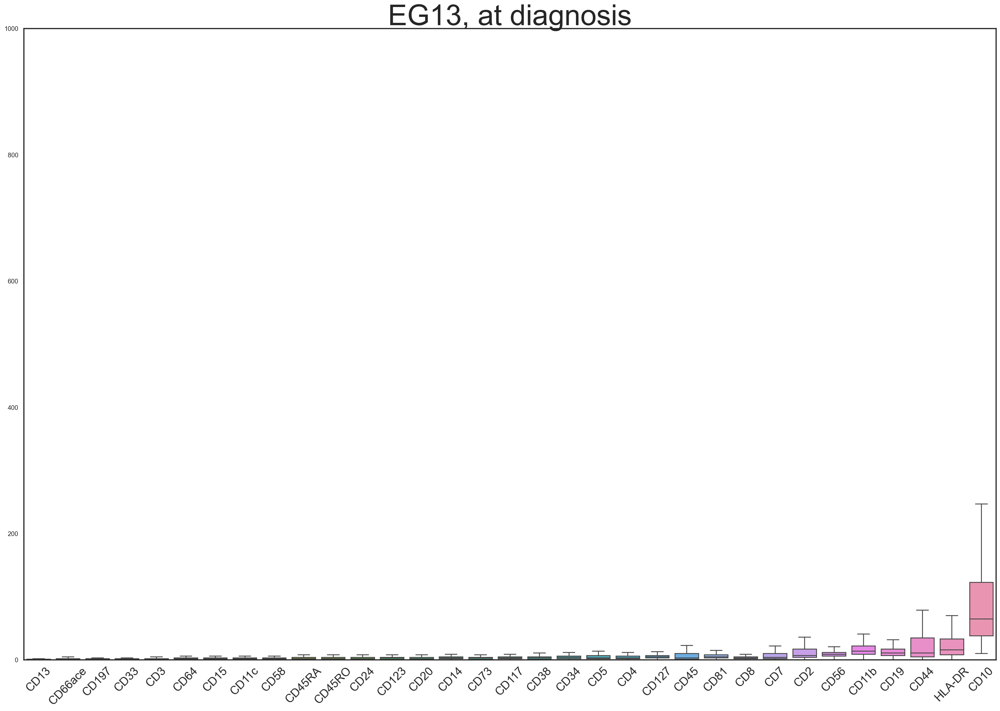

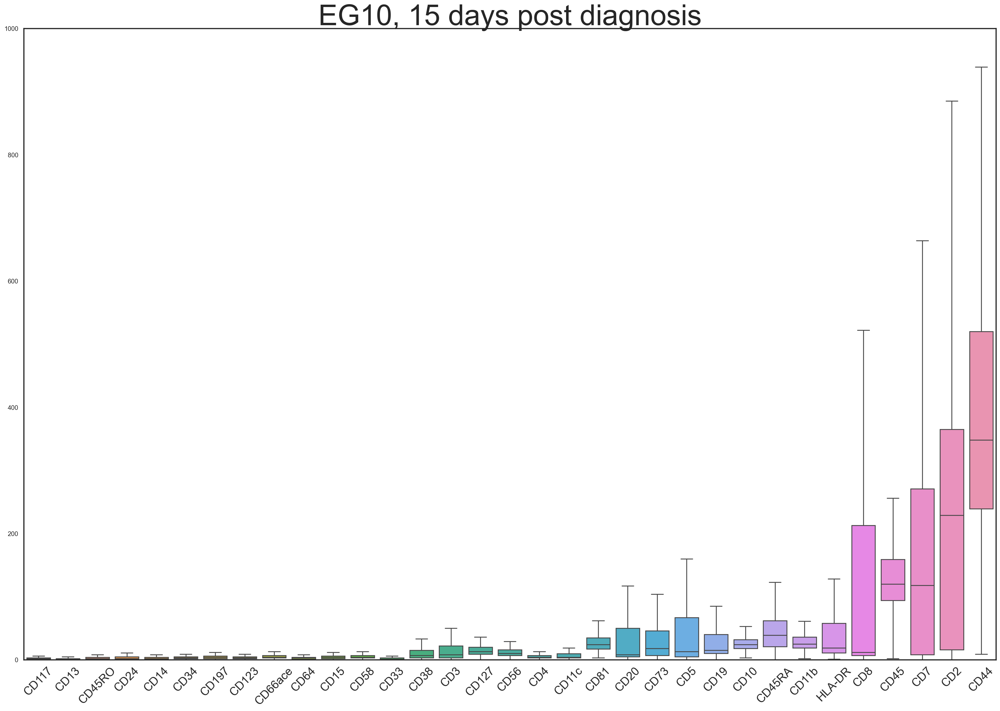

In [114]:
#EG13
plt.figure(figsize=(30,20))
plt.ylim(0, 1000)
d=sns.boxplot(data=df_sorted, fliersize=0)

d.set_xticklabels(d.get_xticklabels(),rotation=45) #rotation
d.tick_params(axis='x', labelsize=20) #increased font
plt.title('EG13, at diagnosis', fontsize = 50)

#EG10
plt.figure(figsize=(30,20))
plt.ylim(0, 1000)
g=sns.boxplot(data=df_sorted2, fliersize=0)


g.set_xticklabels(g.get_xticklabels(),rotation=45) #rotation
g.tick_params(axis='x', labelsize=20) #increased font
plt.title('EG10, 15 days post diagnosis', fontsize = 50)



Text(0.5, 1.0, '15 days post diagnosis')

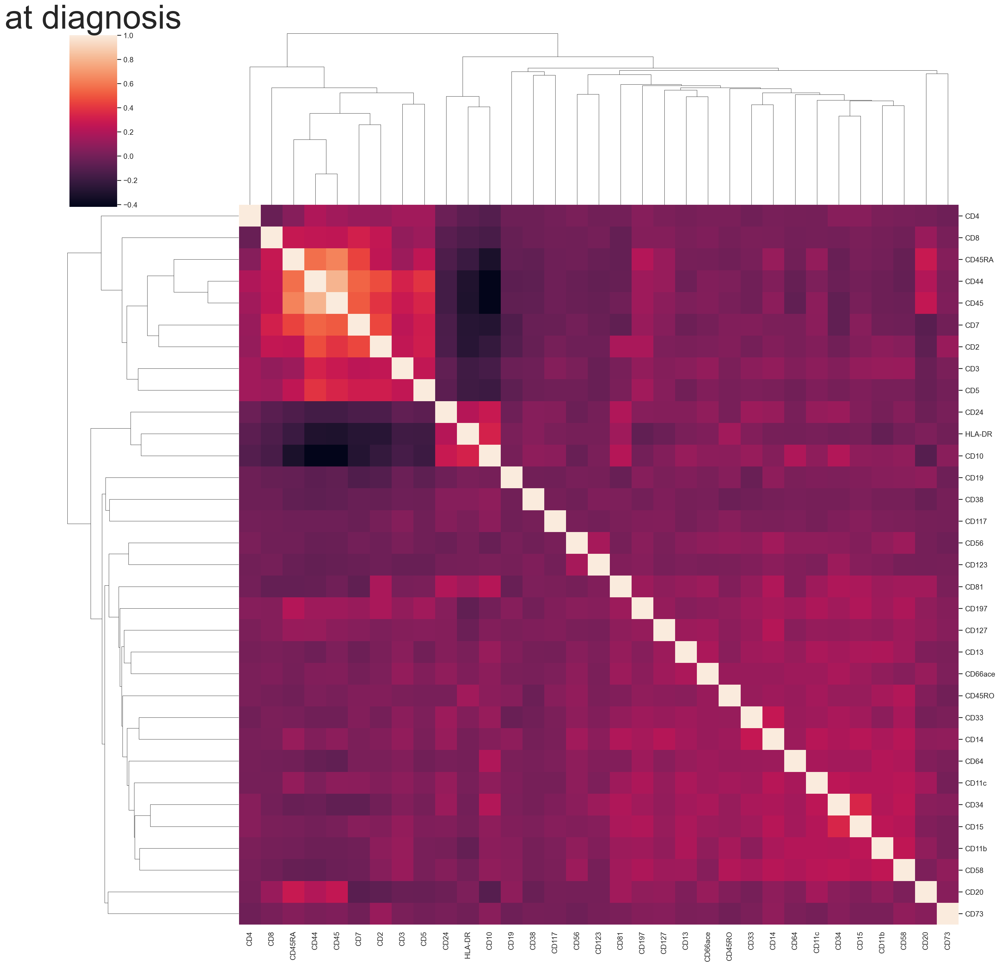

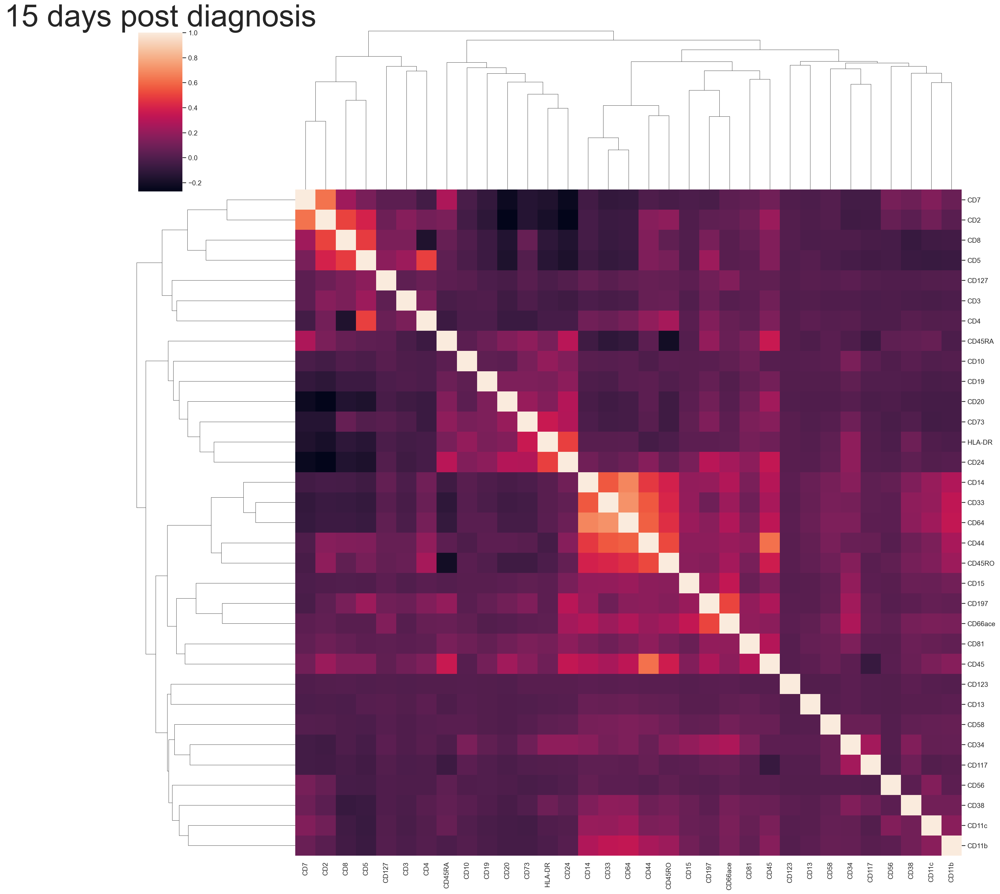

In [60]:
#EG13

matrix_prot2=prot_EG13.corr(method='pearson', min_periods=1)

sns.clustermap(matrix_prot2, figsize=(20,20))

plt.title('at diagnosis', fontsize = 50)

#EG10

matrix_prot=prot_EG10.corr(method='pearson', min_periods=1)

sns.clustermap(matrix_prot, figsize=(20,20))

plt.title('15 days post diagnosis', fontsize = 50)



In [61]:
#list of ranked proteins

# EG13

index_rank_EG13 = prot_EG13.mean().sort_values(ascending=False).index


#EG10

index_rank_EG10 = prot_EG10.mean().sort_values(ascending=False).index


#list of rank numbers
ranks = []
for i in range(1, 34):
    ranks.append(i)



In [62]:
#Dataframe containing ranked proteins from both samples

df_ranks=pd.DataFrame(index_rank_EG13)


df_ranks["EG13"] = pd.DataFrame(index_rank_EG13)
df_ranks["EG10"] = pd.DataFrame(index_rank_EG10)
df_ranks["Rank"] = pd.DataFrame(ranks)



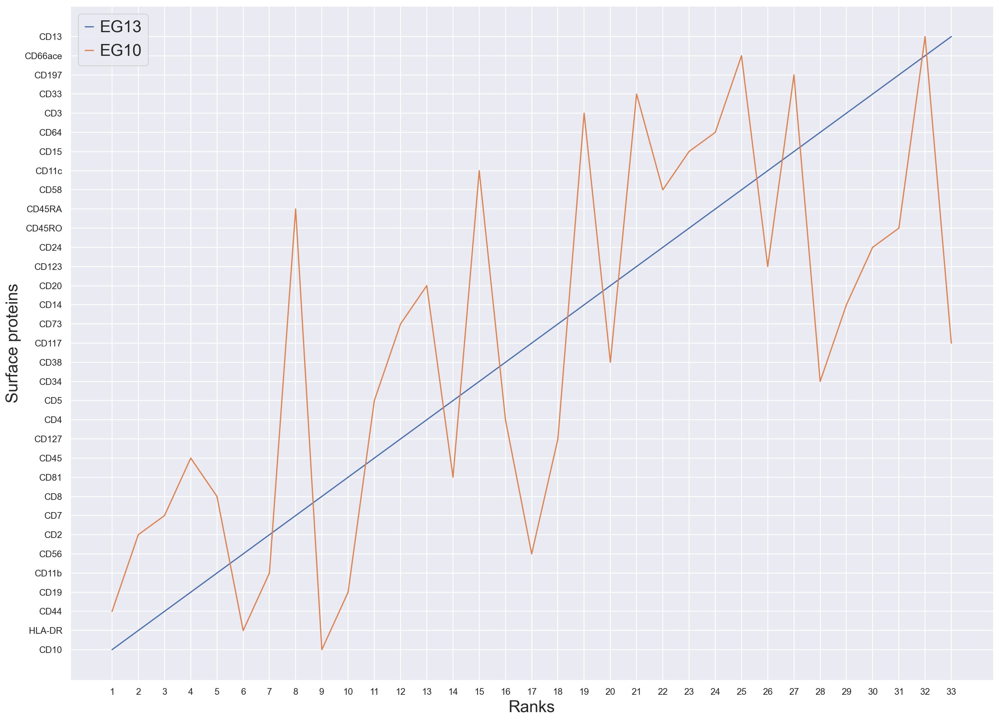

In [63]:
fig, ax = plt.subplots(figsize=(20, 15))

x= df_ranks["Rank"]
y= df_ranks["EG13"]
y2 = df_ranks["EG10"]

ax.plot(x,y,label='EG13')
ax.plot(x,y2,label='EG10')

ax.set_xlabel('Ranks', fontsize=20)  
ax.set_ylabel('Surface proteins', fontsize=20)  

plt.xticks(np.arange(1, 34)) ;
plt.legend(fontsize=20) ;

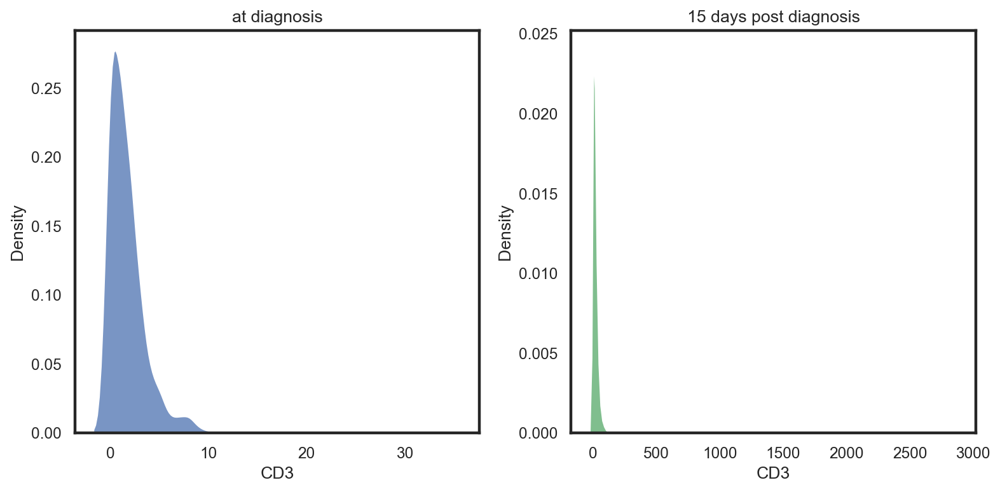

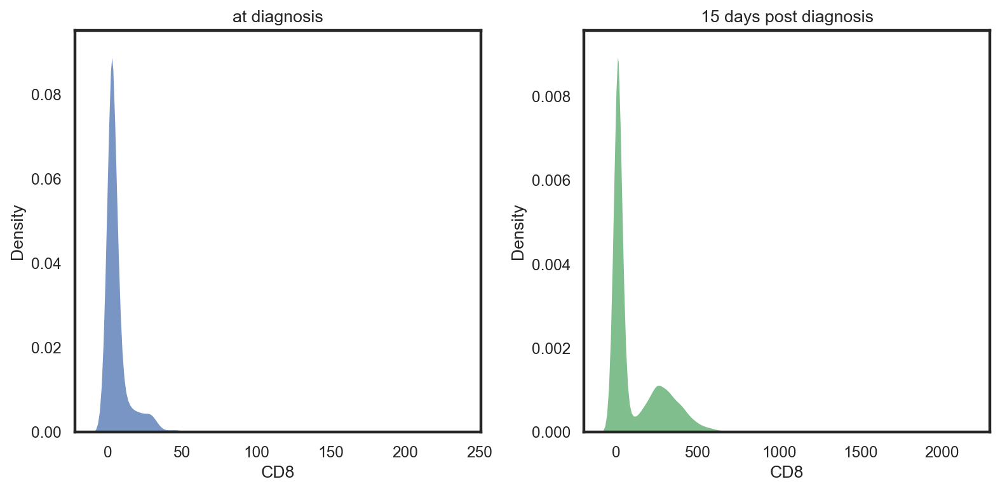

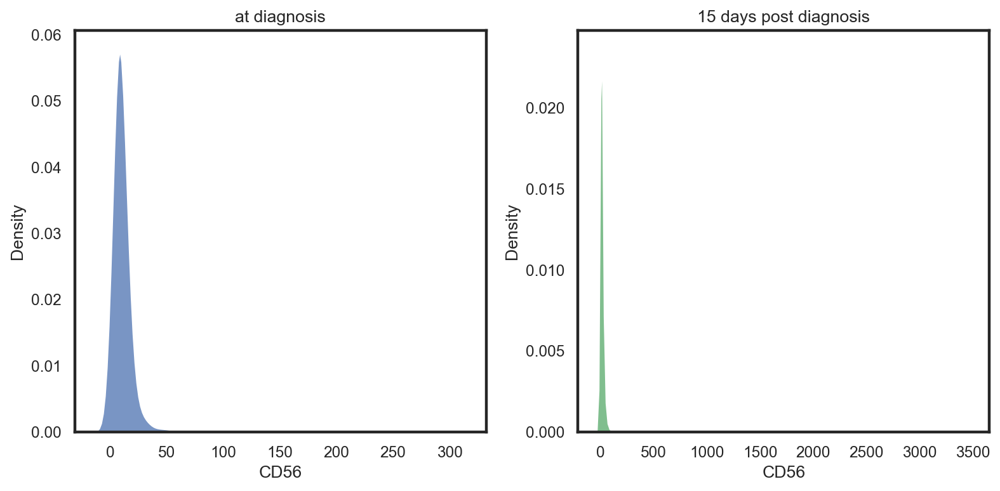

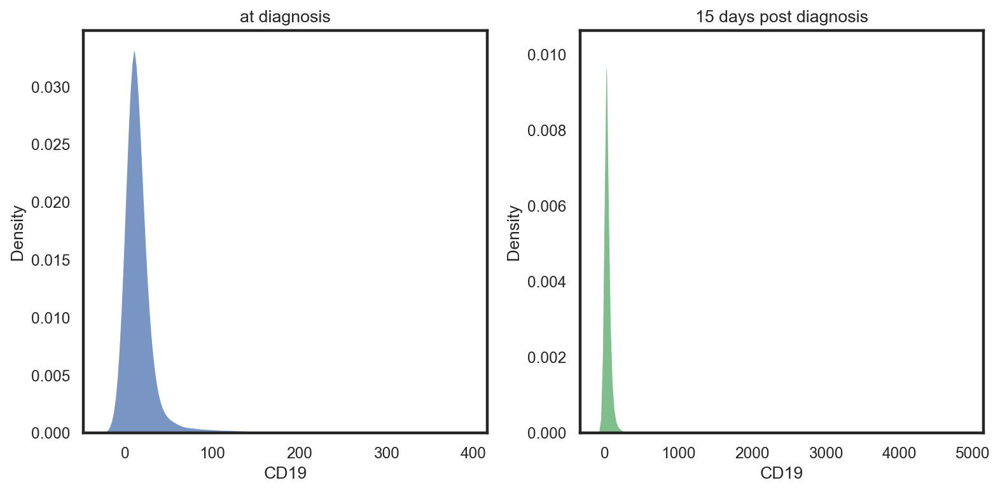

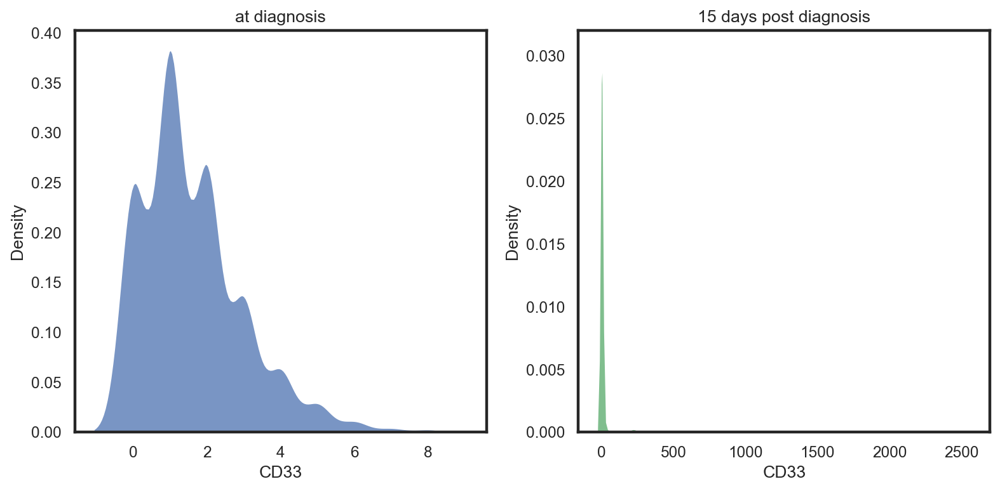

...

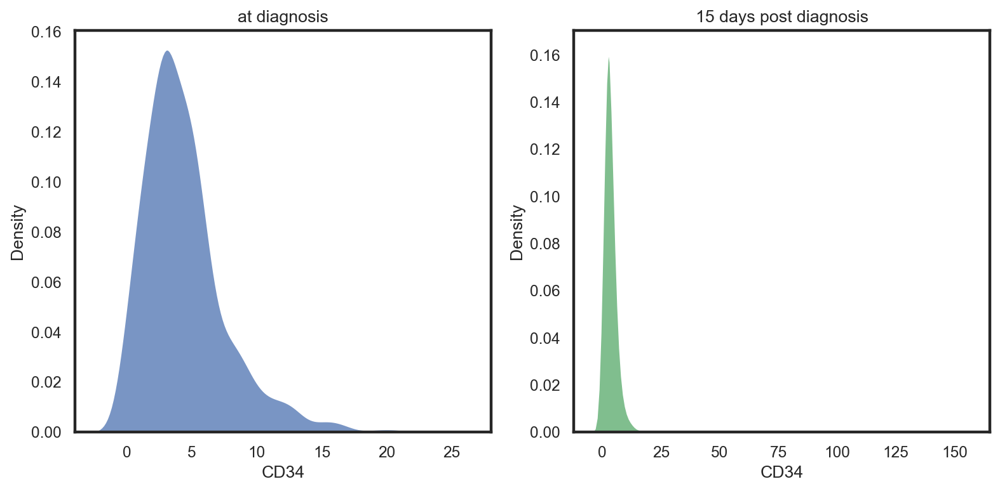

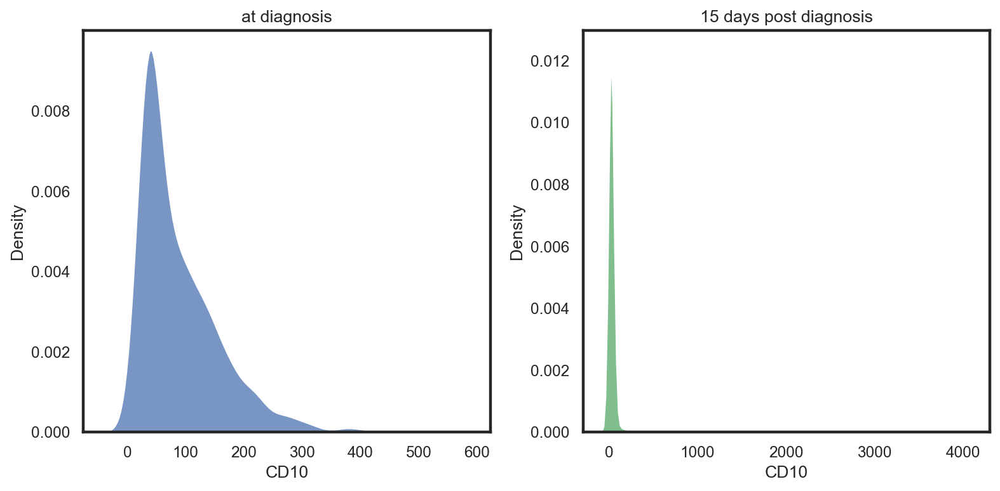

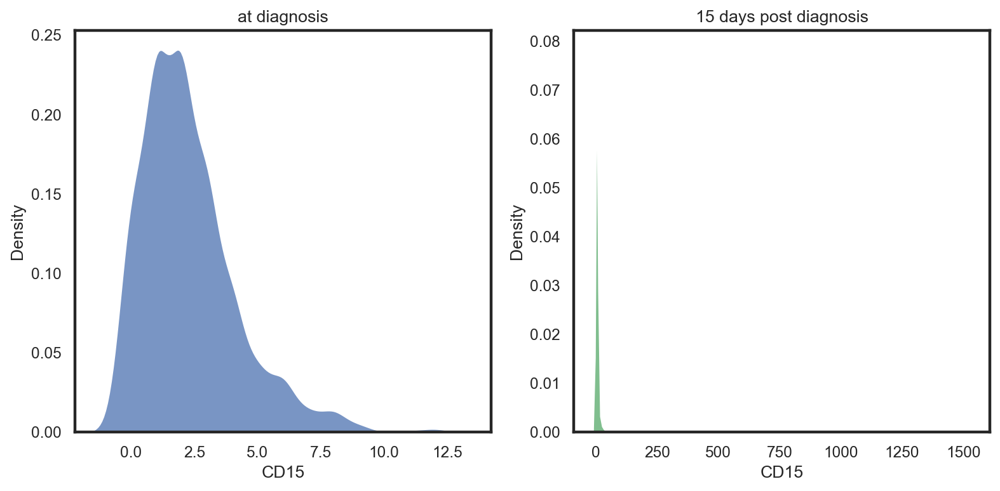

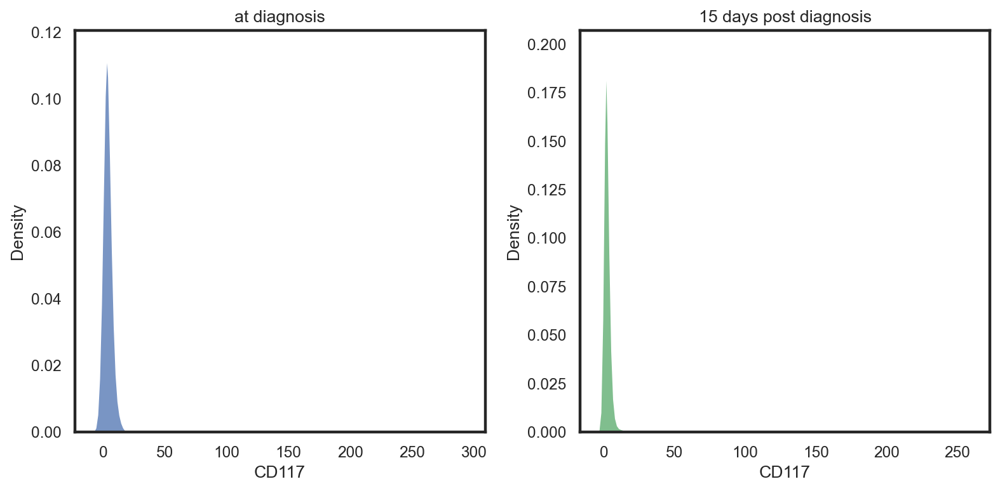

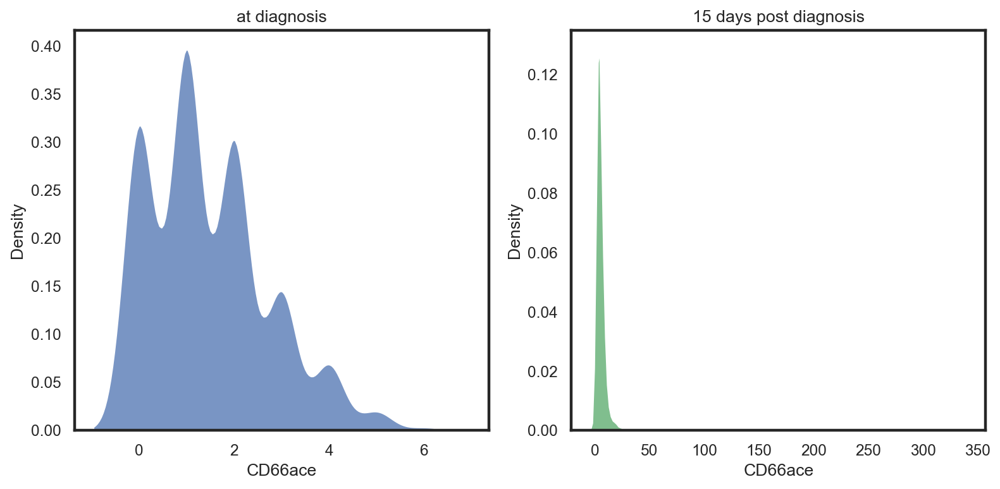

In [82]:
for column_name in column_names:
    fig, ax =plt.subplots(1,2,tight_layout=True, figsize=(10, 5))
    fig.show()

    ax1 = sns.kdeplot(data=prot_EG13, x=column_name, multiple="stack", ax=ax[0]) ;
    ax2 = sns.kdeplot(data=prot_EG10, x=column_name, multiple="stack", color="g", ax=ax[1]) ;
   


    ax1.title.set_text('at diagnosis')    #headings for subplots
    ax2.title.set_text('15 days post diagnosis')
    plt.show()

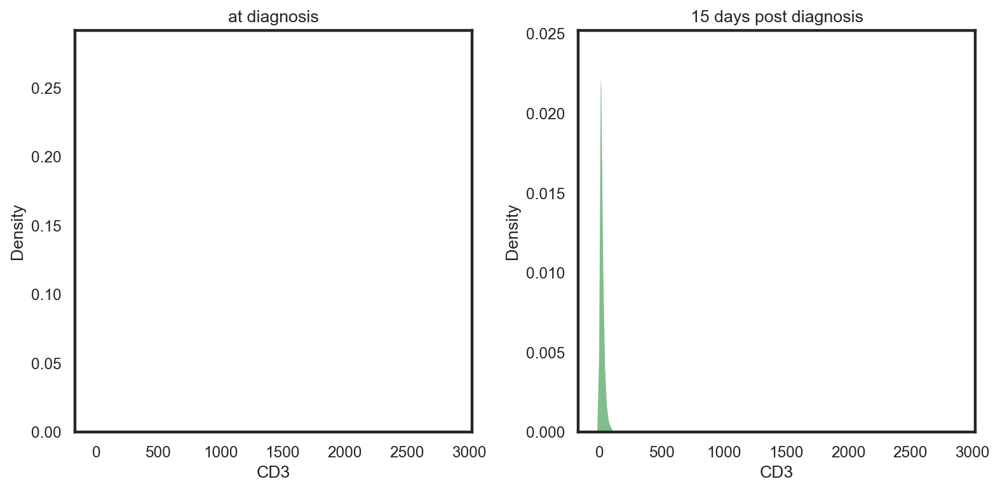

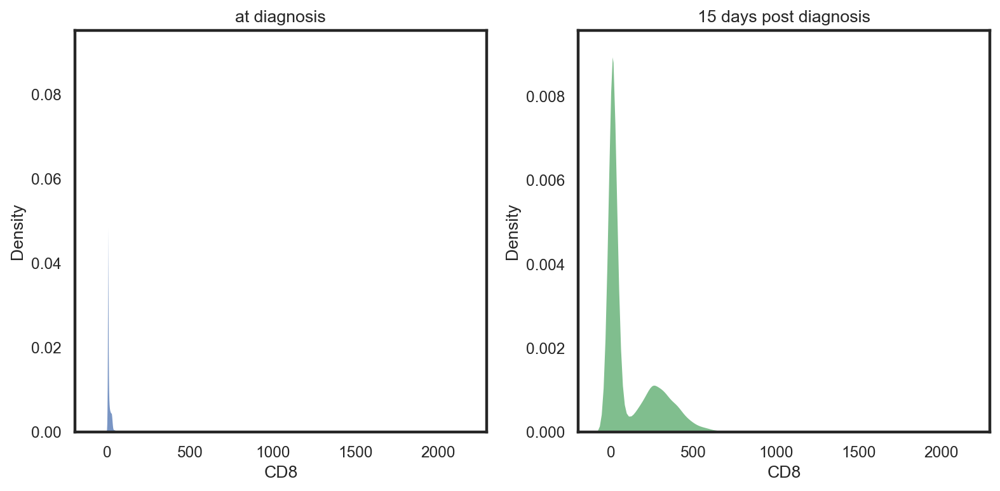

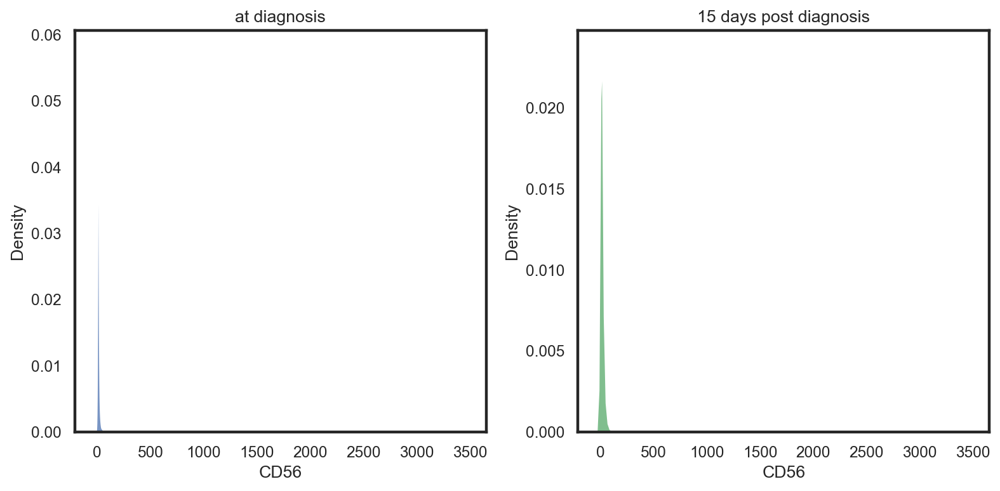

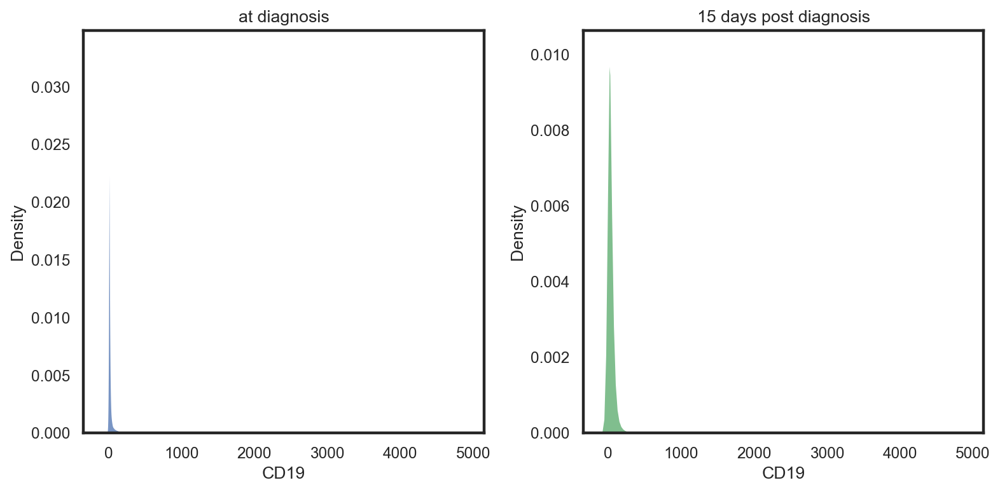

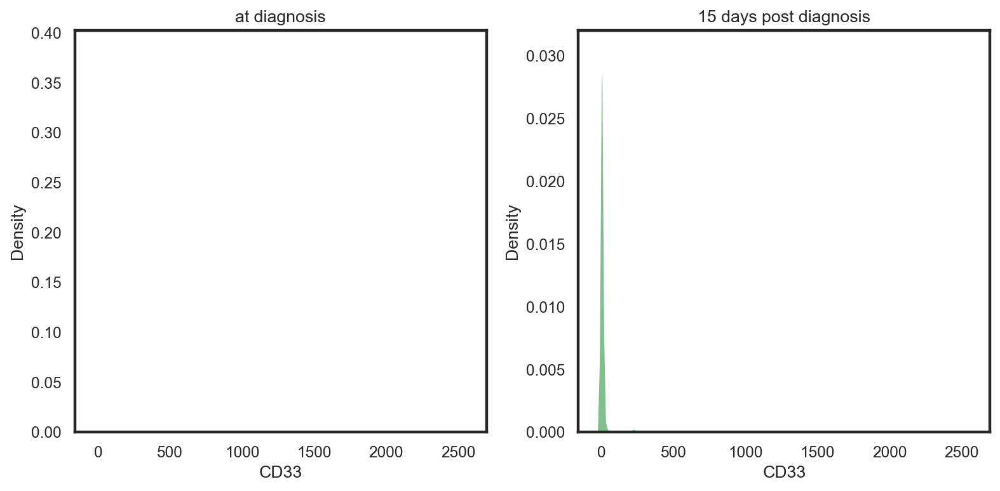

...

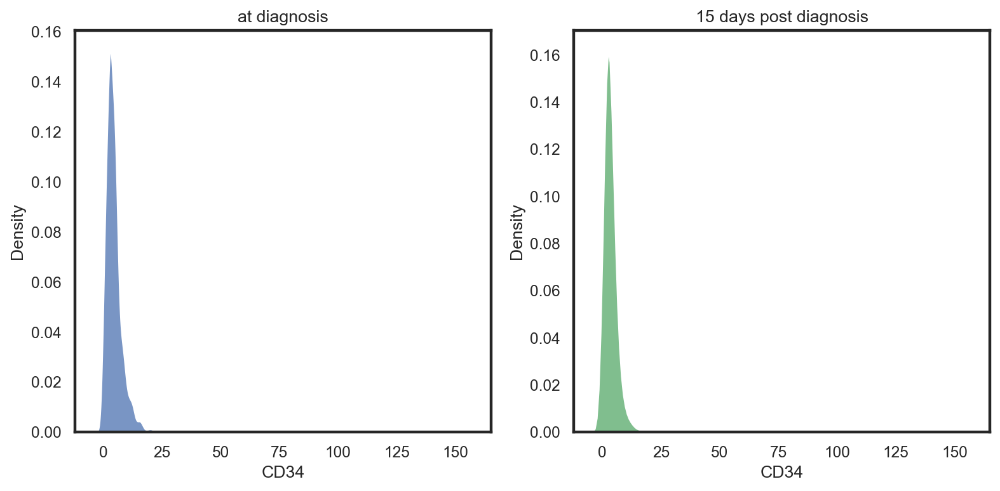

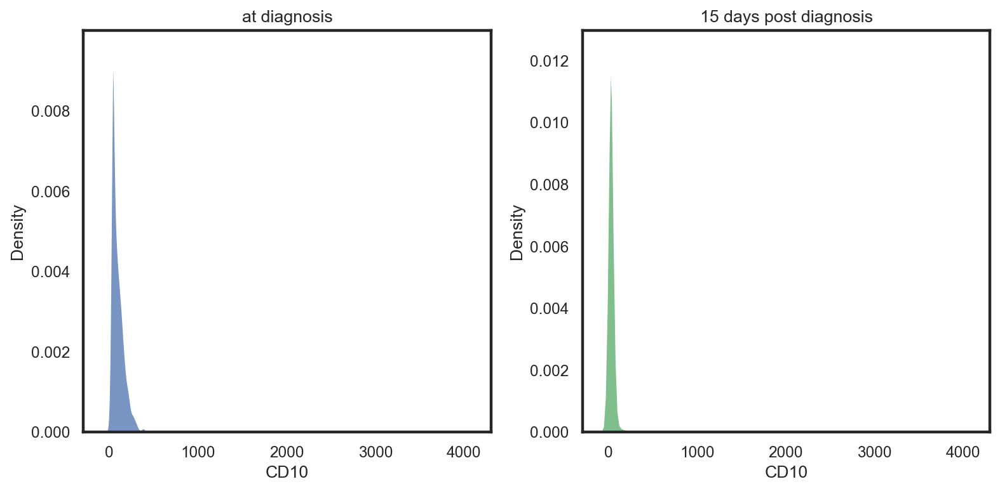

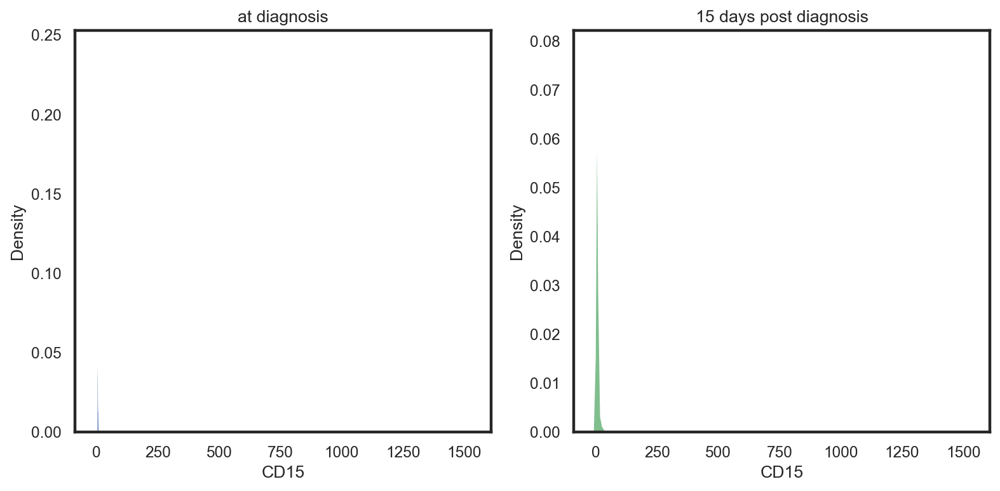

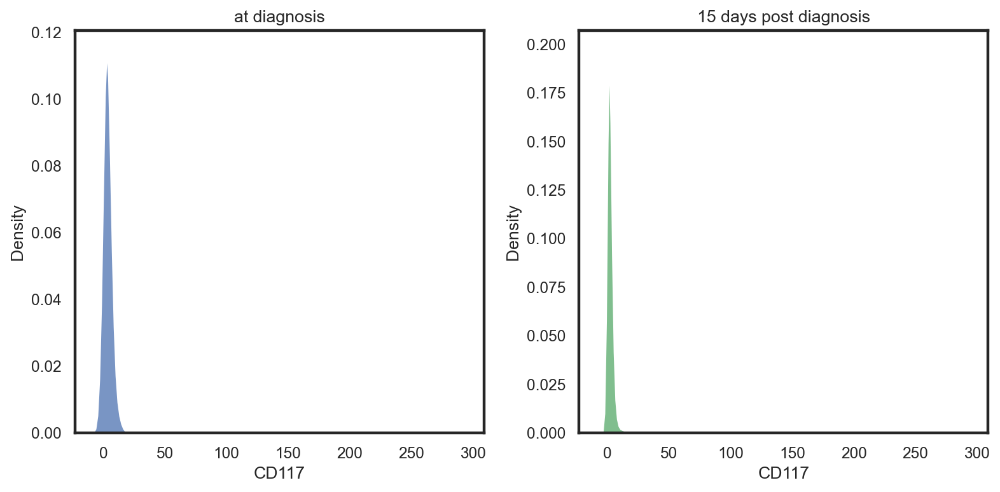

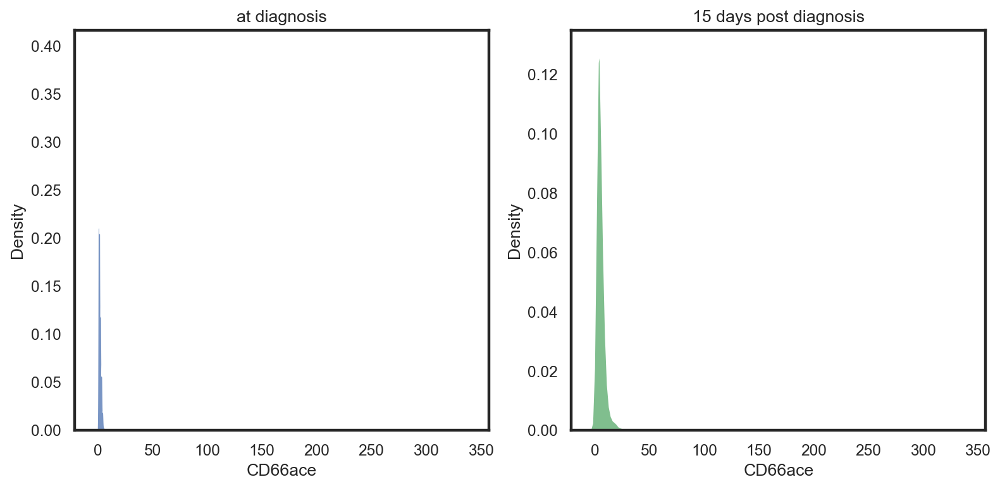

In [72]:
#Same x-axis 

for column_name in column_names:
    fig, ax =plt.subplots(1,2,tight_layout=True, figsize=(10, 5), sharex=True) #same x axis
    fig.show()

    ax1 = sns.kdeplot(data=prot_EG13, x=column_name, multiple="stack", ax=ax[0]) ;
    ax2 = sns.kdeplot(data=prot_EG10, x=column_name, multiple="stack", color="g", ax=ax[1]) ;
   


    ax1.title.set_text('at diagnosis')    #headings for subplots
    ax2.title.set_text('15 days post diagnosis')
    plt.show()

In [121]:
protein_expression_filtered2.shape

(6262, 33)

In [117]:
#EG13

df1 = adata.obs
df_result1 = pd.concat([df1, protein_expression_filtered], axis=1)

#add surface protein information from anndata.obsm to anndata.obs

adata.obs = df_result1

adata.obs.shape


(845, 56)

In [116]:
#EG10

df2 = adata2.obs
df_result2 = pd.concat([df2, protein_expression_filtered2], axis=1)

#add to anndata.obs

adata2.obs = df_result2

adata2.obs.shape

(6262, 54)

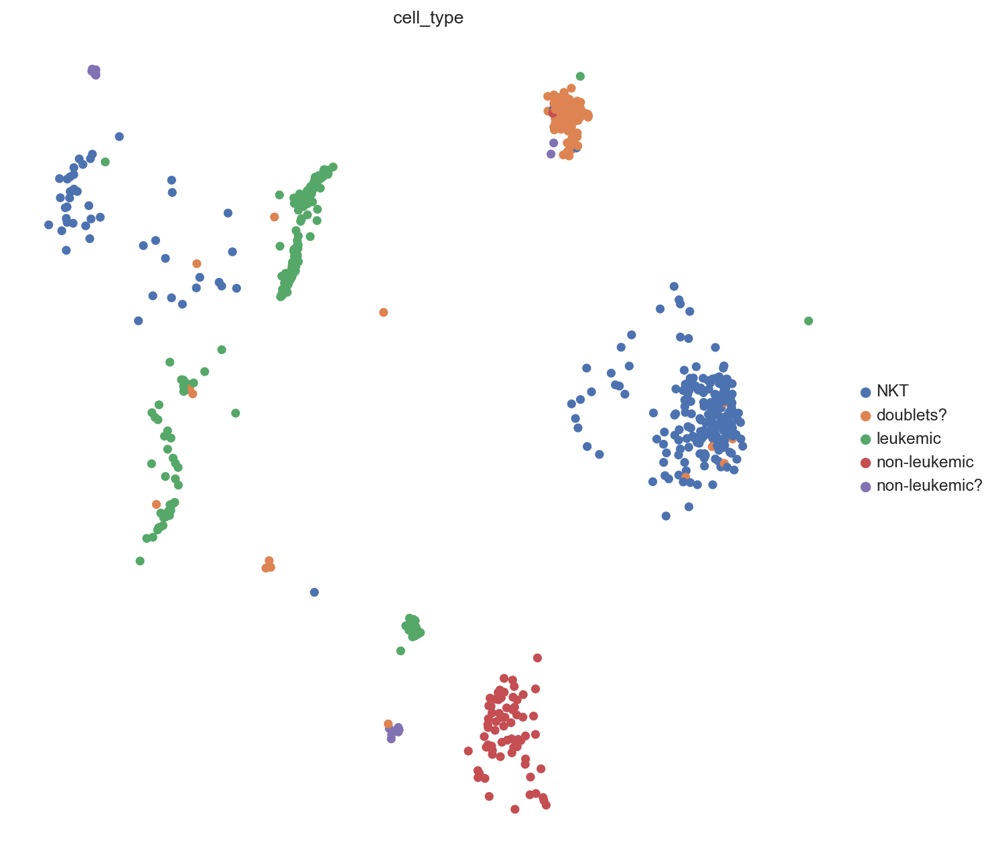

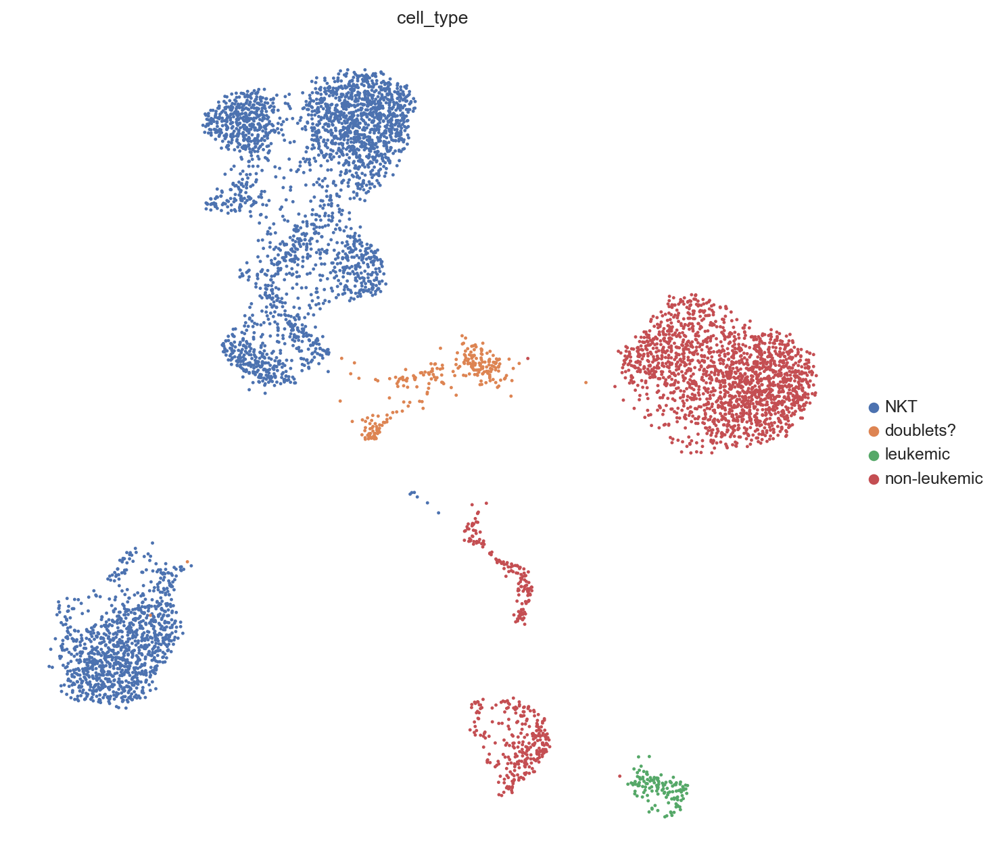

In [136]:
#at diagnosis

sc.pl.umap(
    adata,
    color=['cell_type'],
    frameon=False,
    vmax="p99",
)
plt.show()

#post diagnosis
sc.pl.umap(
    adata2,
    color=['cell_type'],
    frameon=False,
    vmax="p99",
)

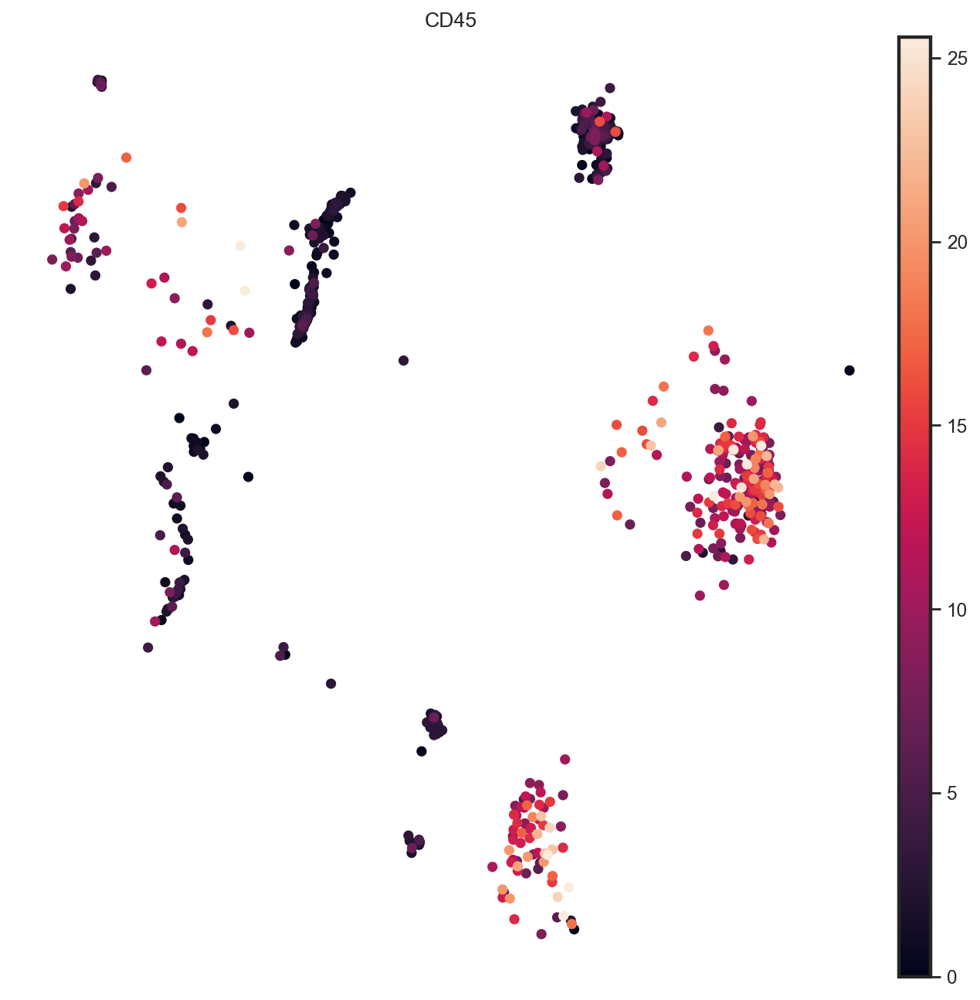

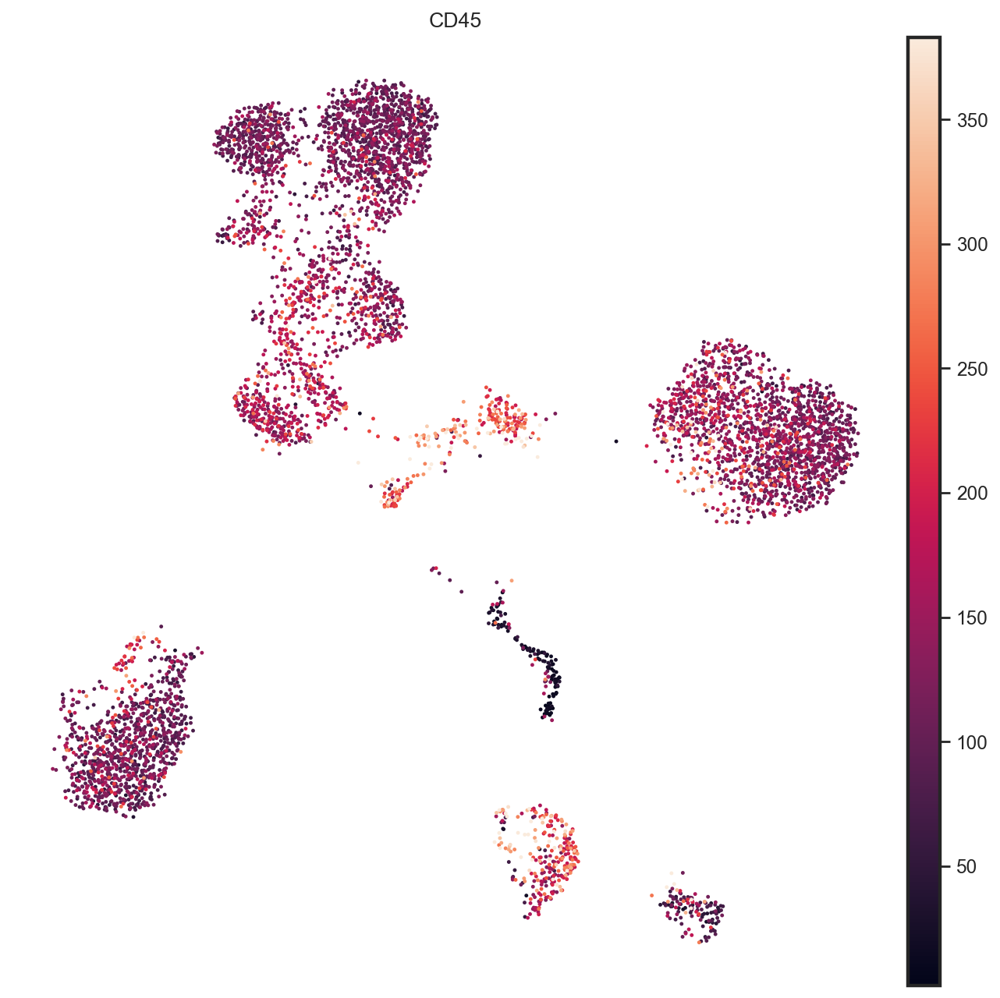

In [131]:
sc.pl.umap(adata,   #EG13, diagnosis
    color=['CD45'],
    frameon=False,
    vmax="p99",
)



sc.pl.umap(adata2,    #EG10, post diagnosis
    color=['CD45'],
    frameon=False,
    vmax="p99",
)





In [ ]:
#Both samples combined in one dataframe

c= prot_EG13
d= prot_EG10

df_c = pd.DataFrame(data=c)
df_c['Sample']="EG13"

df_d = pd.DataFrame(data=d)
df_d['Sample']="EG10"

#concatenate previous dataframes
df_both=pd.concat([df_c, df_d])
df_both



In [ ]:
sns.kdeplot(data=df_both, x="CD44", hue="Sample", multiple="stack") ;

In [ ]:
sns.violinplot(data=df_both, x="CD56", y="Sample") ;

# Normalized data from same samples

In [28]:
#all CLR data

adata_prot_clr= sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/adata_prot_clr.h5ad')

In [29]:
#all DSB data

adata_prot_dsb= sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/adata_prot_dsb.h5ad')

In [30]:
#picking EG10 and EG13 samples

eg10_clr=adata_prot_clr[adata_prot_clr.obs['EG_code'] == 'EG10']

In [31]:
eg13_clr=adata_prot_clr[adata_prot_clr.obs['EG_code'] == 'EG13']

In [32]:
#picking EG10 and EG13 samples

eg10_dsb=adata_prot_dsb[adata_prot_dsb.obs['EG_code'] == 'EG10']

In [33]:
eg13_dsb=adata_prot_dsb[adata_prot_dsb.obs['EG_code'] == 'EG13']

In [35]:
eg13_clr = eg13_clr.to_df()
eg10_clr = eg10_clr.to_df()

In [36]:
eg13_dsb = eg13_dsb.to_df()
eg10_dsb = eg10_dsb.to_df()

In [37]:
eg10_dsb

,CD19,CD10,CD20,CD3,CD2,CD11b,HLADR,CD38,CD11c,CD7,...,CD5,CD15,CD64,CD117,CD24,CD44,CD58,CD66ace,CD13,CD34
AAACCTGAGATCGGGT-1,-1.227712,-0.079973,-0.043934,5.104354,16.567026,-0.666104,1.325765,2.836796,0.876088,14.019156,...,11.090464,0.463894,0.603483,1.923302,0.051516,11.221979,1.834181,0.357217,1.919708,-0.026487
AAACCTGAGCTGCCCA-1,1.037210,-0.560365,2.097772,1.061533,11.757624,1.974177,1.134338,16.690966,16.274235,21.388950,...,0.644951,0.908526,-0.680680,-0.165842,0.051516,8.336772,0.862596,-0.613060,-0.735727,-0.026487
AAACCTGAGTCAAGGC-1,1.479029,-0.560365,0.757874,6.926298,15.868343,-0.666104,-0.482723,2.163235,-0.285708,21.272982,...,14.472557,-0.529547,-0.680680,-0.991498,1.901219,12.817587,0.862596,0.791482,0.652425,0.627242
AAACCTGCAAGGTTTC-1,-0.885738,-1.099720,-0.043934,-0.747464,11.405987,0.265327,-1.069650,5.144601,7.338480,18.275793,...,-0.474413,-0.013703,-0.011814,0.587922,1.014948,10.723041,-0.259016,-0.613060,0.652425,-1.515554
AAACCTGCAGACGCAA-1,0.801671,-0.079973,0.757874,-0.239965,14.078522,0.536040,0.508169,15.870083,5.246038,23.217331,...,1.145942,0.463894,-1.413340,1.923302,0.051516,9.480280,0.323381,2.279395,4.164847,-0.737131
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCAGTTGGGACA-1,0.024855,0.069168,1.465120,0.659128,7.682884,8.886184,8.872905,10.825758,6.364643,2.811445,...,2.054813,3.376761,14.854552,-0.991498,1.901219,18.349775,7.101470,2.279395,7.825135,0.627242
TTTGTCATCGCCATAA-1,-0.885738,-0.394337,-0.969555,9.523600,17.892099,2.420964,0.279378,2.163235,-0.285708,16.094942,...,4.855299,0.463894,0.603483,-0.165842,-1.003803,15.126046,2.691180,-0.109244,1.919708,0.627242
TTTGTCATCGGTTAAC-1,7.370492,-0.394337,9.175179,0.226889,0.363651,-0.496278,4.285989,2.163235,-0.285708,-0.243355,...,0.644951,1.324451,-0.680680,-0.991498,6.671053,11.840477,0.323381,1.197710,0.652425,-0.026487
TTTGTCATCGTCTGCT-1,3.261914,0.619788,11.261201,-0.239965,0.363651,-0.496278,6.721145,7.009827,1.396070,0.228701,...,-0.474413,-1.090301,-1.413340,-0.165842,2.721778,10.792775,-1.585602,1.579302,0.652425,1.795984


In [38]:
column_names=eg10_dsb.columns

In [39]:
column_names

Index(['CD19', 'CD10', 'CD20', 'CD3', 'CD2', 'CD11b', 'HLADR', 'CD38', 'CD11c',
       'CD7', 'CD45', 'CD33', 'CD81', 'CD73', 'CD123', 'CD14', 'CD45RA',
       'CD45RO', 'CD4', 'CD8a', 'CD197', 'CD127', 'CD56', 'CD5', 'CD15',
       'CD64', 'CD117', 'CD24', 'CD44', 'CD58', 'CD66ace', 'CD13', 'CD34'],
      dtype='object')

In [40]:
#sorting by mean 

index_sort = eg10_clr.mean().sort_values().index
df_sorted = eg10_clr[index_sort]

In [41]:

index_sort = eg13_clr.mean().sort_values().index
df_sorted2 = eg13_clr[index_sort]

In [42]:

index_sort = eg10_dsb.mean().sort_values().index
df_sorted3 = eg10_dsb[index_sort]

In [43]:

index_sort = eg13_dsb.mean().sort_values().index
df_sorted4 = eg13_dsb[index_sort]

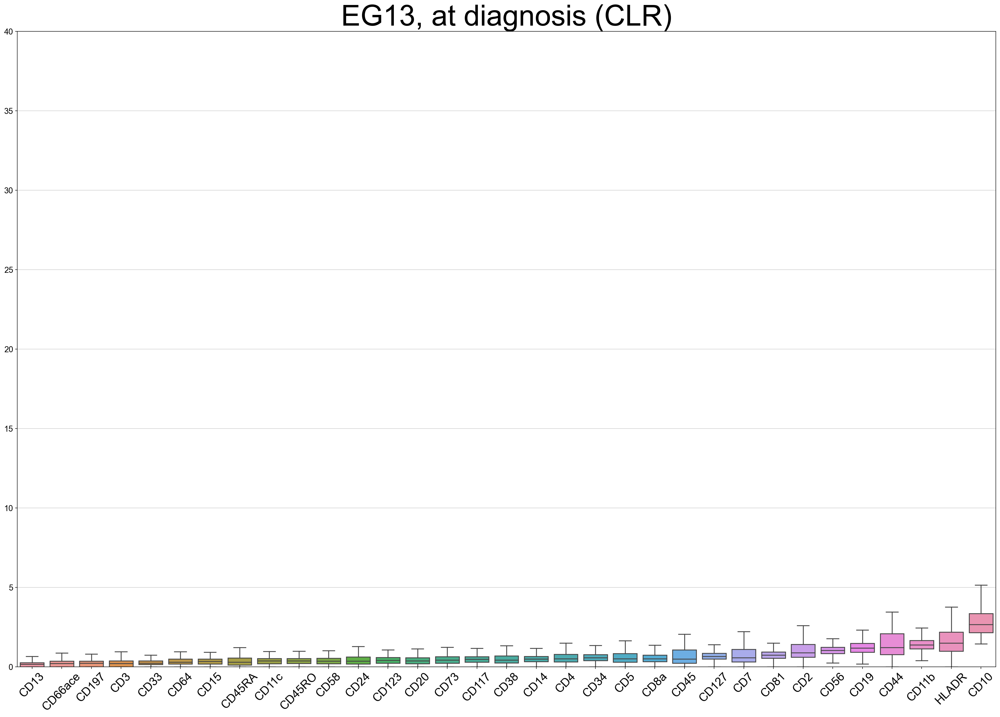

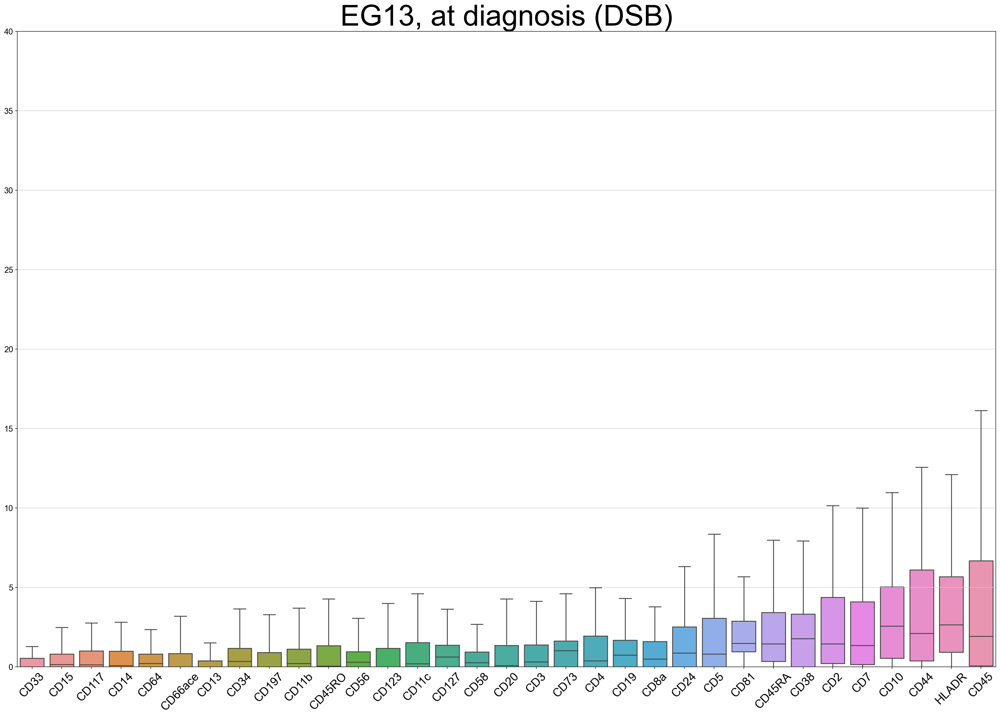

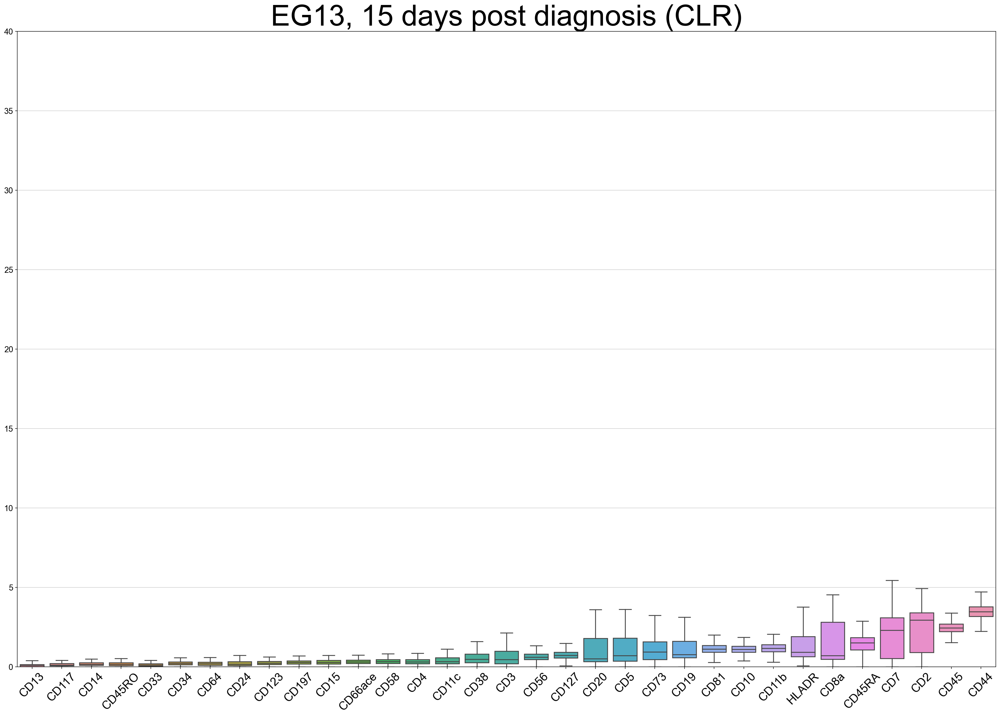

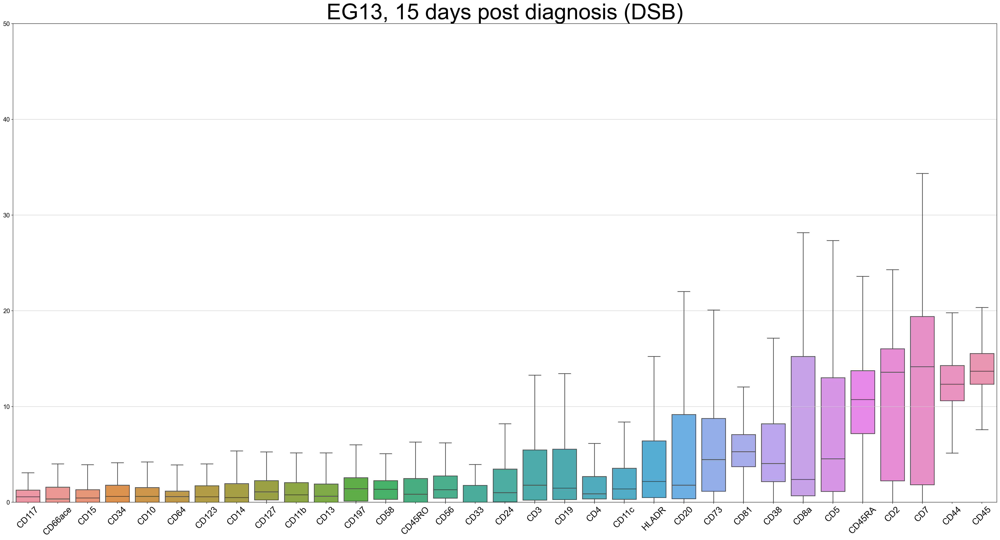

In [47]:
#EG13

#CLR
plt.figure(figsize=(30,20))
plt.ylim(0, 40)
a=sns.boxplot(data=df_sorted2, fliersize=0)

a.set_xticklabels(a.get_xticklabels(),rotation=45) #rotation
a.tick_params(axis='x', labelsize=20) #increased font
plt.title('EG13, at diagnosis (CLR)', fontsize = 50)
plt.show()

#DSB
plt.figure(figsize=(30,20))
plt.ylim(0, 40)
b=sns.boxplot(data=df_sorted4, fliersize=0)

b.set_xticklabels(b.get_xticklabels(),rotation=45) #rotation
b.tick_params(axis='x', labelsize=20) #increased font
plt.title('EG13, at diagnosis (DSB)', fontsize = 50)


#EG10

plt.figure(figsize=(30,20))
plt.ylim(0, 40)
c=sns.boxplot(data=df_sorted, fliersize=0)

c.set_xticklabels(c.get_xticklabels(),rotation=45) #rotation
c.tick_params(axis='x', labelsize=20) #increased font
plt.title('EG13, 15 days post diagnosis (CLR)', fontsize = 50)
plt.show()


plt.figure(figsize=(40,20))
plt.ylim(0, 50)
d=sns.boxplot(data=df_sorted3, fliersize=0)

d.set_xticklabels(d.get_xticklabels(),rotation=45) #rotation
d.tick_params(axis='x', labelsize=20) #increased font
plt.title('EG13, 15 days post diagnosis (DSB)', fontsize = 50)
plt.show()

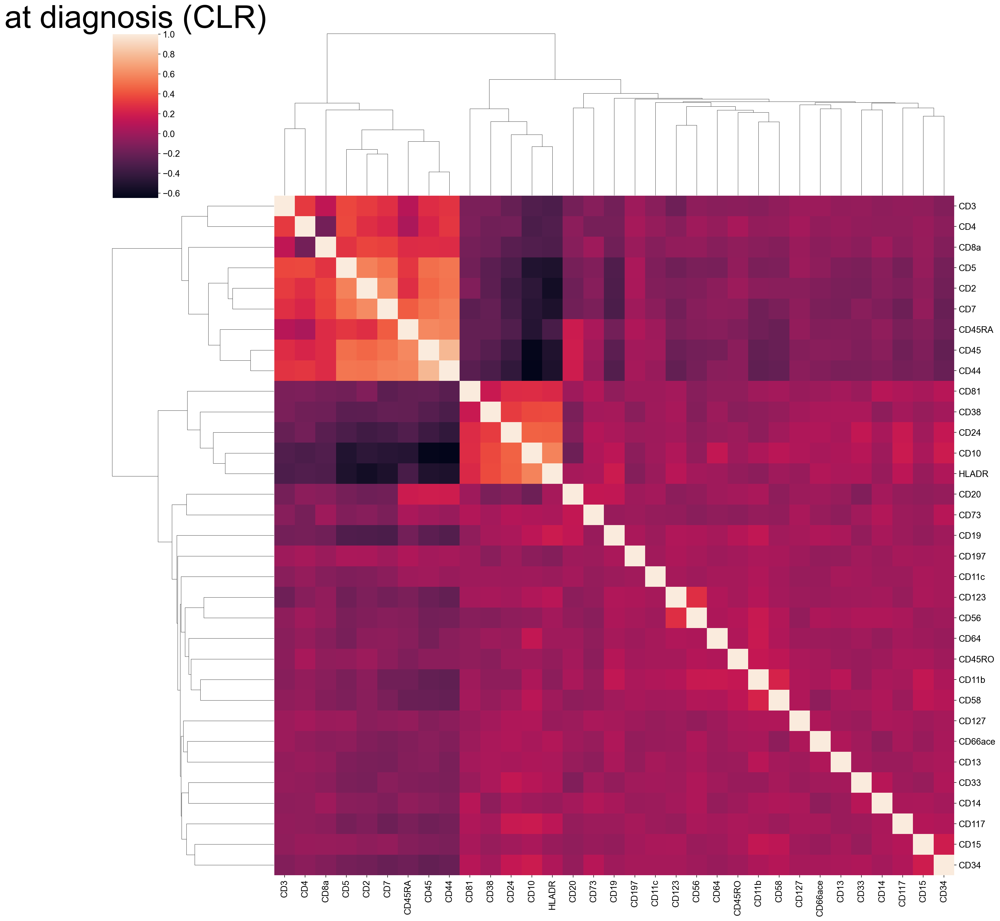

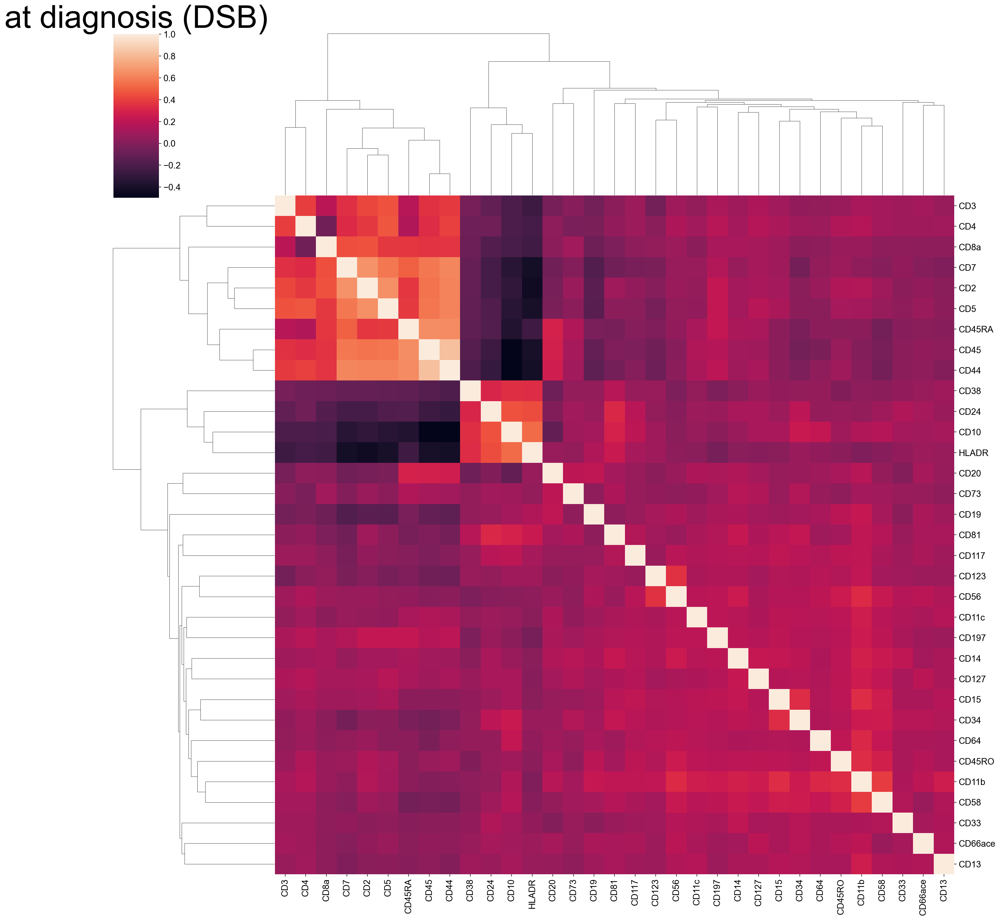

In [54]:
#EG13

matrix_prot2=eg13_clr.corr(method='pearson', min_periods=1)
sns.clustermap(matrix_prot2, figsize=(20,20))
plt.title('at diagnosis (CLR)', fontsize = 50)

matrix_prot22=eg13_dsb.corr(method='pearson', min_periods=1)
sns.clustermap(matrix_prot22, figsize=(20,20))
plt.title('at diagnosis (DSB)', fontsize = 50) ;



### Comments:
- Similar clustering with both normalization methods
- Clear cluster in the upper left corner: T-cell markers: CD3, CD4, CD8a, 
- Maybe another cluster within the larger cluster: T-cell markers: CD7, CD2, CD5, CD45RA (naive T), CD45 (HCS marker), CD44 (early T)
- Also clear cluster: early B-cell markers: CD38, CD24, CD10

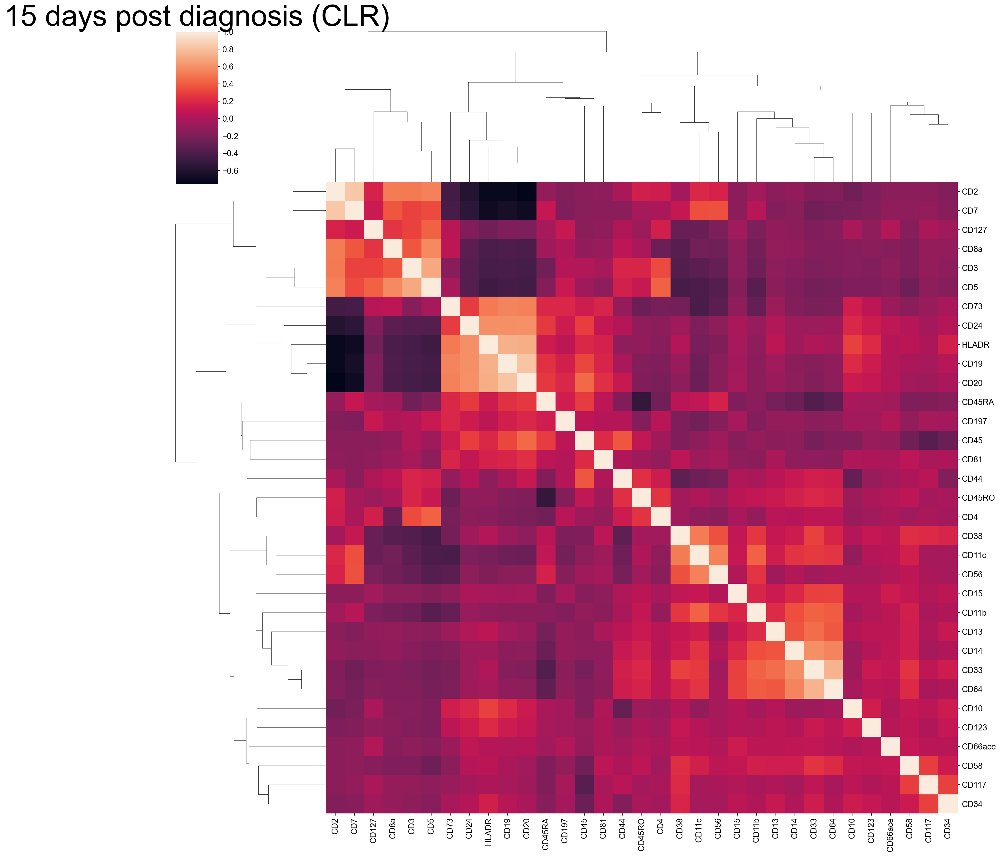

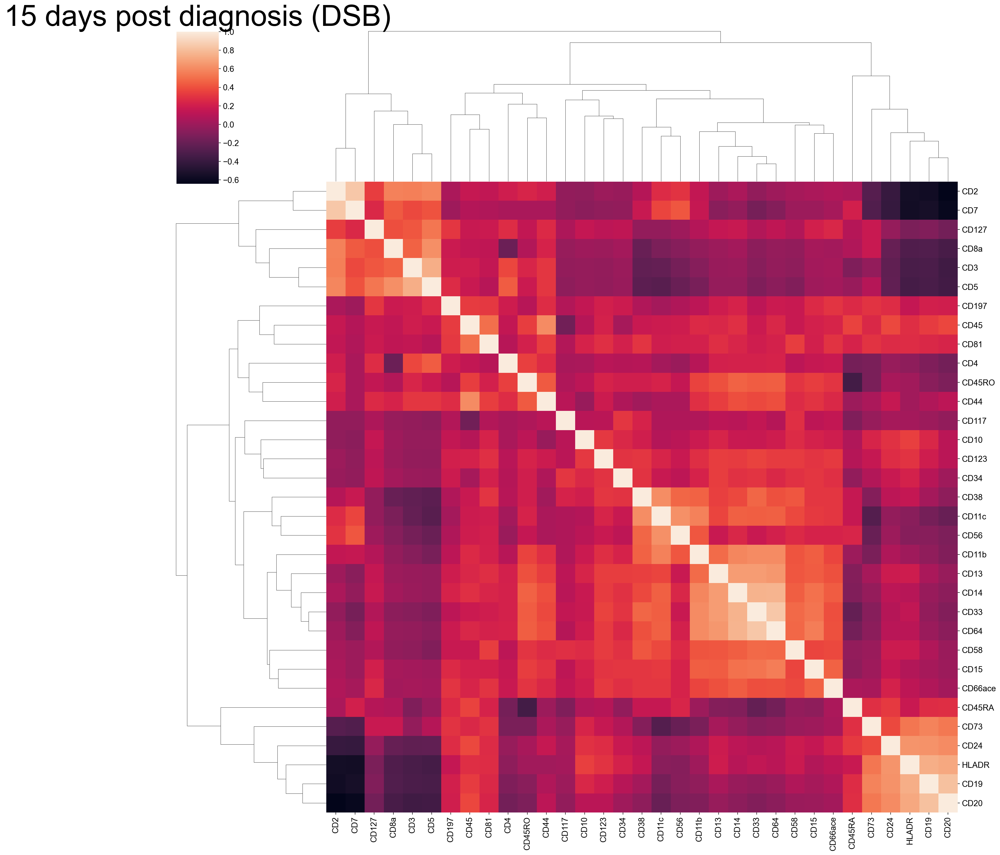

In [69]:
#EG10

matrix_prot3=eg10_clr.corr(method='pearson', min_periods=1)
sns.clustermap(matrix_prot3, figsize=(20,20))
plt.title('15 days post diagnosis (CLR)', fontsize = 50)


matrix_prot33=eg10_dsb.corr(method='pearson', min_periods=1)
sns.clustermap(matrix_prot33, figsize=(20,20))
plt.title('15 days post diagnosis (DSB)', fontsize = 50) ;


### Comments: 
- Similar cluster in upper left corner: T-cell markers CD2, CD7, CD127, CD8a, CD3, CD5
- Also clusters of B-cell markers: CD73, CD24, HLA-DR, CD19, CD20
- Myeloid lineage present: CD11b, CD13, CD14, CD33, CD64
- CD38, CD11c, CD56.. ?
- clearly higher diversity of cell types present

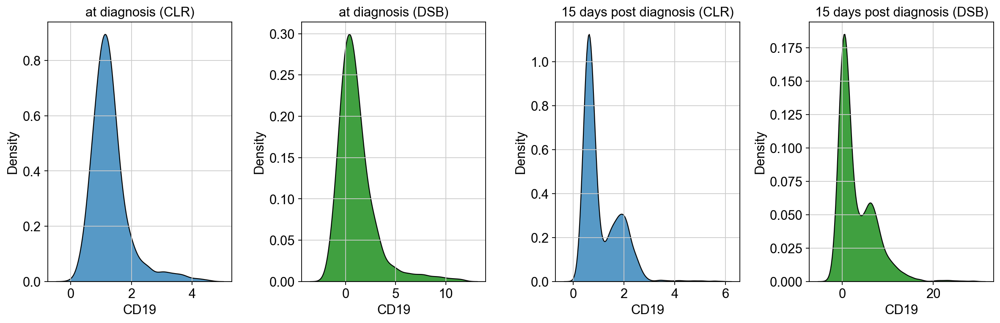

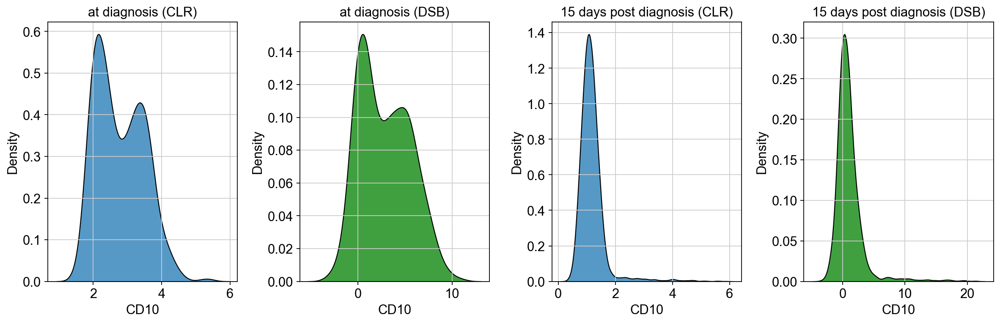

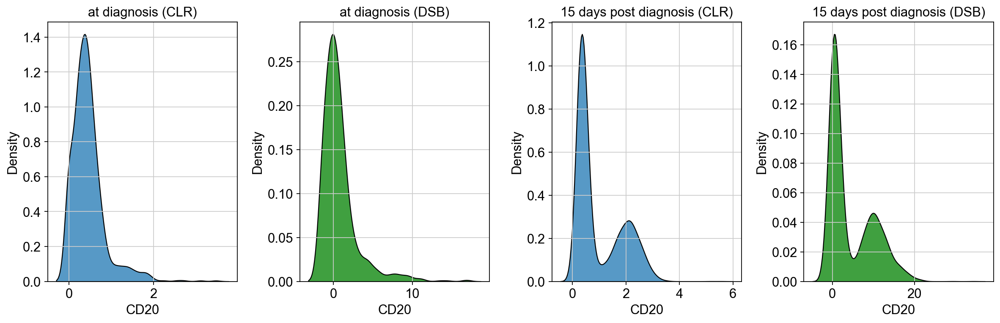

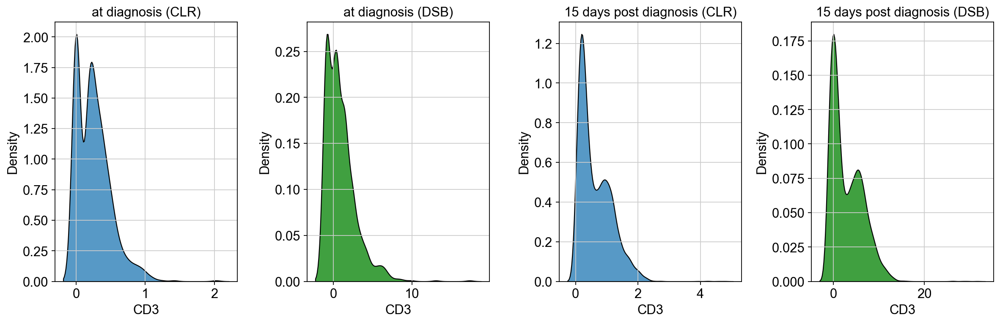

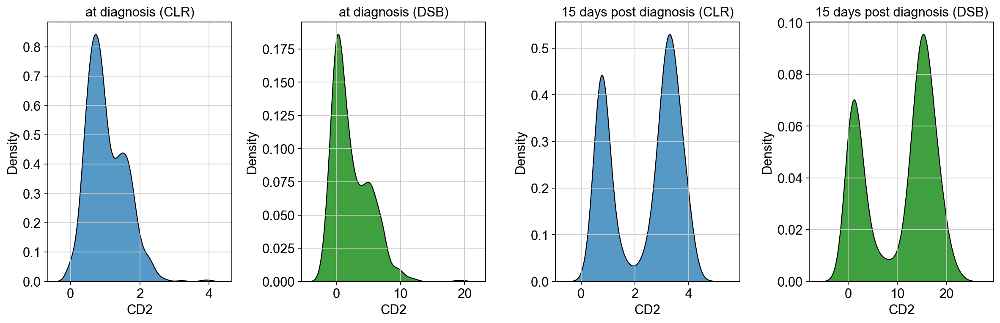

...

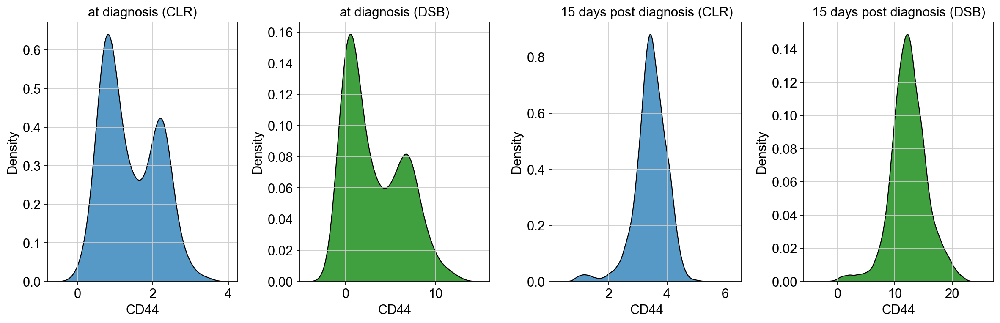

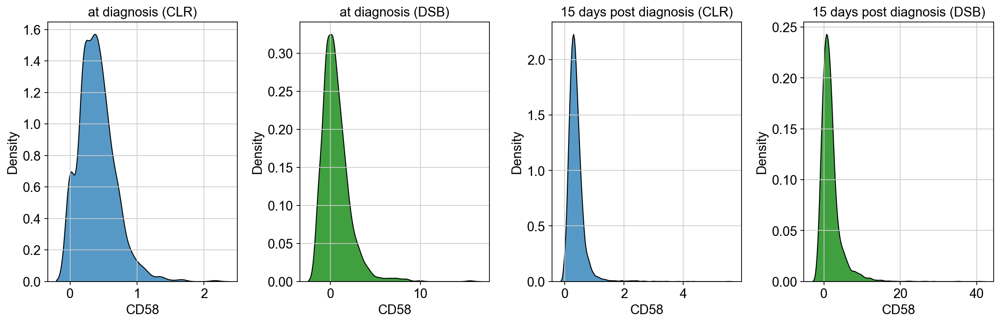

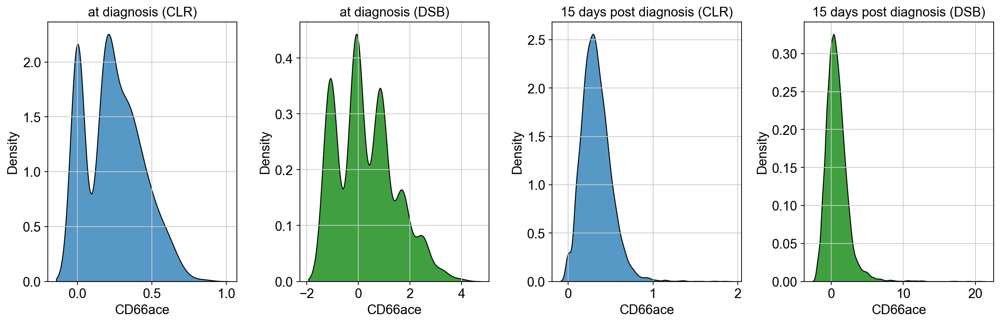

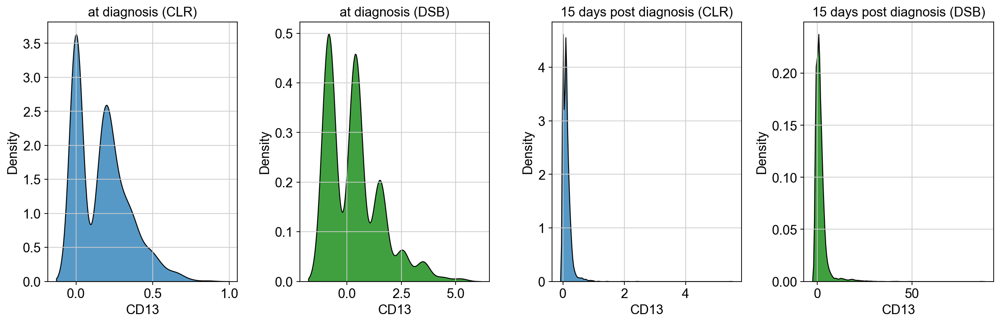

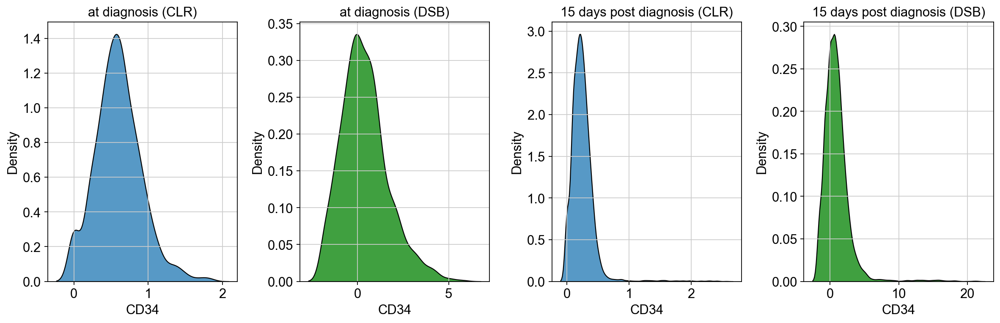

In [64]:
#all proteins

for column_name in column_names:
    fig, ax =plt.subplots(1,4,tight_layout=True, figsize=(15, 5))
    fig.show()

    ax1 = sns.kdeplot(data=eg13_clr, x=column_name, multiple="stack", ax=ax[0]) ;
    ax2 = sns.kdeplot(data=eg13_dsb, x=column_name, multiple="stack", color="g", ax=ax[1]) ;
   
    ax1.title.set_text('at diagnosis (CLR)')    
    ax2.title.set_text('at diagnosis (DSB)')
    
    ax3 = sns.kdeplot(data=eg10_clr, x=column_name, multiple="stack", ax=ax[2]) ;
    ax4 = sns.kdeplot(data=eg10_dsb, x=column_name, multiple="stack", color="g", ax=ax[3]) ;

    ax3.title.set_text('15 days post diagnosis (CLR)')    
    ax4.title.set_text('15 days post diagnosis (DSB)')
    
    plt.show()

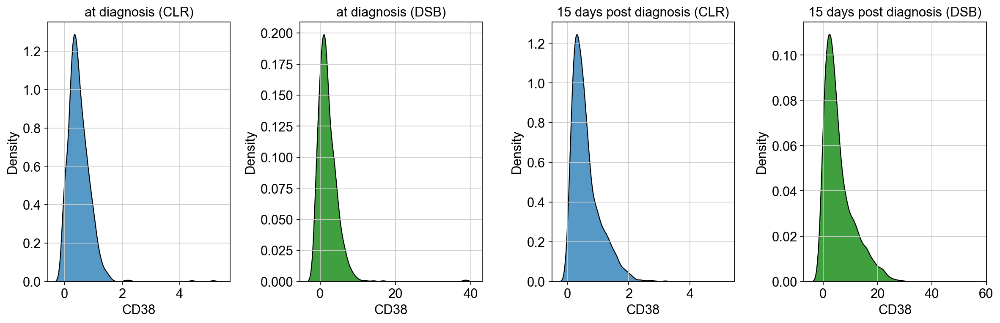

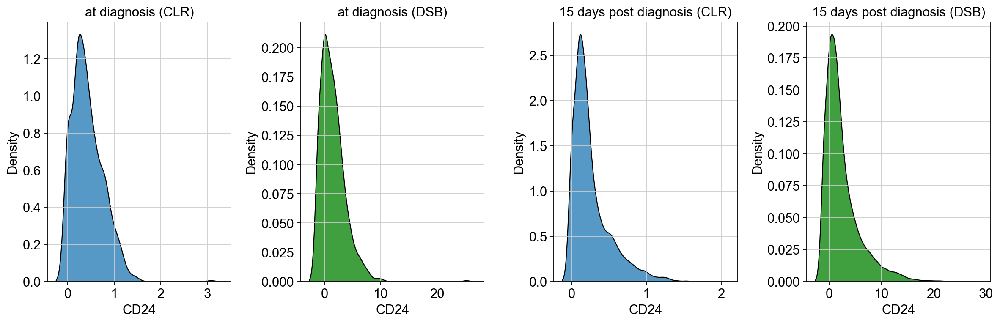

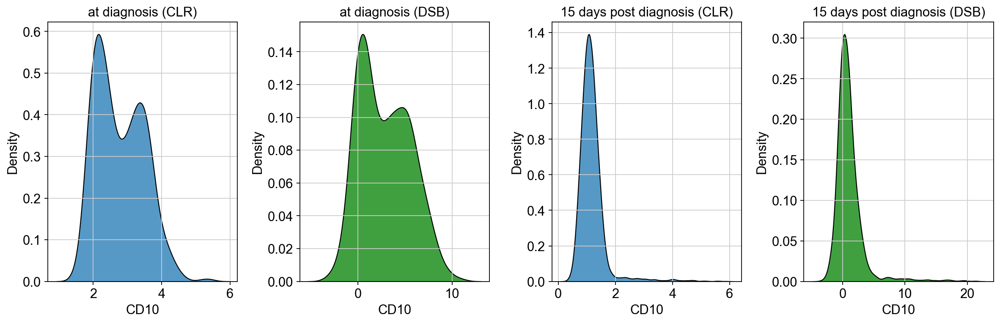

In [67]:
#early B-cell markers: CD38, CD24, CD10   #early B-cell markers
    
markers = ["CD38", 'CD24', 'CD10']
    
for column_name in markers:
    fig, ax =plt.subplots(1,4,tight_layout=True, figsize=(15, 5))
    fig.show()

    ax1 = sns.kdeplot(data=eg13_clr, x=column_name, multiple="stack", ax=ax[0]) ;
    ax2 = sns.kdeplot(data=eg13_dsb, x=column_name, multiple="stack", color="g", ax=ax[1]) ;
   
    ax1.title.set_text('at diagnosis (CLR)')    
    ax2.title.set_text('at diagnosis (DSB)')
    
    ax3 = sns.kdeplot(data=eg10_clr, x=column_name, multiple="stack", ax=ax[2]) ;
    ax4 = sns.kdeplot(data=eg10_dsb, x=column_name, multiple="stack", color="g", ax=ax[3]) ;

    ax3.title.set_text('15 days post diagnosis (CLR)')    
    ax4.title.set_text('15 days post diagnosis (DSB)')
    
    plt.show()

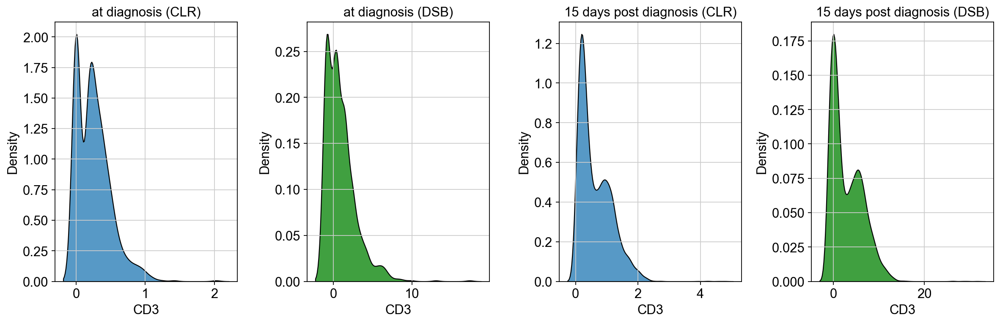

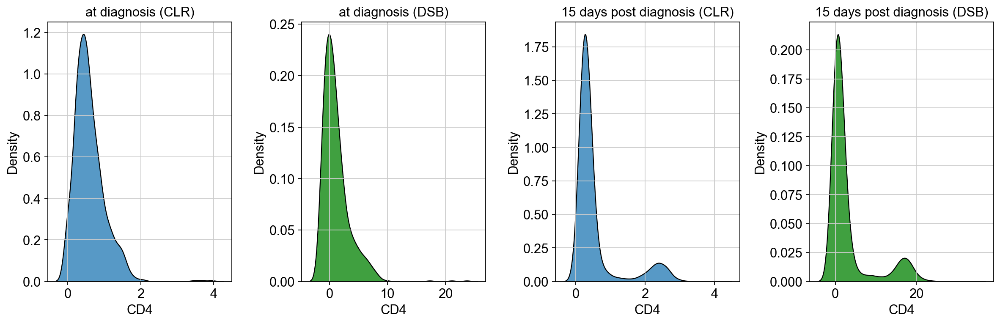

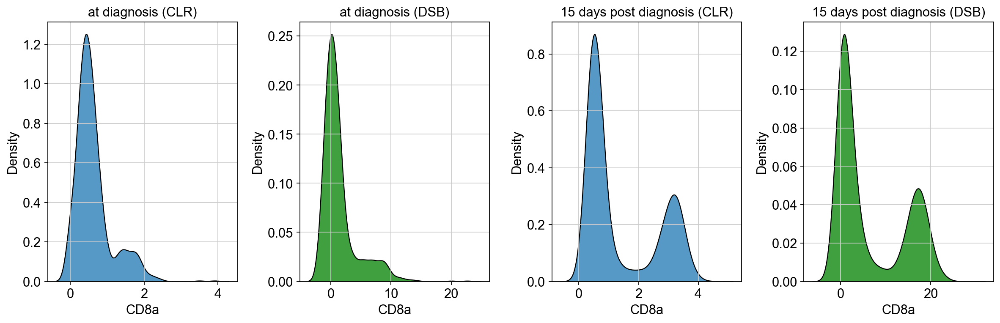

In [68]:
markers = ["CD3", 'CD4', 'CD8a']  #T-cell markers
    
for column_name in markers:
    fig, ax =plt.subplots(1,4,tight_layout=True, figsize=(15, 5))
    fig.show()

    ax1 = sns.kdeplot(data=eg13_clr, x=column_name, multiple="stack", ax=ax[0]) ;
    ax2 = sns.kdeplot(data=eg13_dsb, x=column_name, multiple="stack", color="g", ax=ax[1]) ;
   
    ax1.title.set_text('at diagnosis (CLR)')    
    ax2.title.set_text('at diagnosis (DSB)')
    
    ax3 = sns.kdeplot(data=eg10_clr, x=column_name, multiple="stack", ax=ax[2]) ;
    ax4 = sns.kdeplot(data=eg10_dsb, x=column_name, multiple="stack", color="g", ax=ax[3]) ;

    ax3.title.set_text('15 days post diagnosis (CLR)')    
    ax4.title.set_text('15 days post diagnosis (DSB)')
    
    plt.show()


### Comments:
- Early B-markers = working as expected, densities of early B-cell markers is lower in 15 days post diagnosis samples
- T-cell markers = increased 15 days post diagnosis

## UMAPs

In [89]:
import umap

reducer = umap.UMAP()

embedding = pd.DataFrame(reducer.fit_transform(eg13_clr), columns = ['UMAP1','UMAP2'])

### Notes:

- Killer/cytotocix T-cells: CD8a, 
- Helper T: CD4+
- T-reg: VD4+, CD127+

## T-cell markers, at diagnosis (EG13)


In [131]:
#markers
t_cell=["CD3", 'CD4', 'CD8a', 'CD127']

In [120]:
column_names

Index(['CD19', 'CD10', 'CD20', 'CD3', 'CD2', 'CD11b', 'HLADR', 'CD38', 'CD11c',
       'CD7', 'CD45', 'CD33', 'CD81', 'CD73', 'CD123', 'CD14', 'CD45RA',
       'CD45RO', 'CD4', 'CD8a', 'CD197', 'CD127', 'CD56', 'CD5', 'CD15',
       'CD64', 'CD117', 'CD24', 'CD44', 'CD58', 'CD66ace', 'CD13', 'CD34'],
      dtype='object')

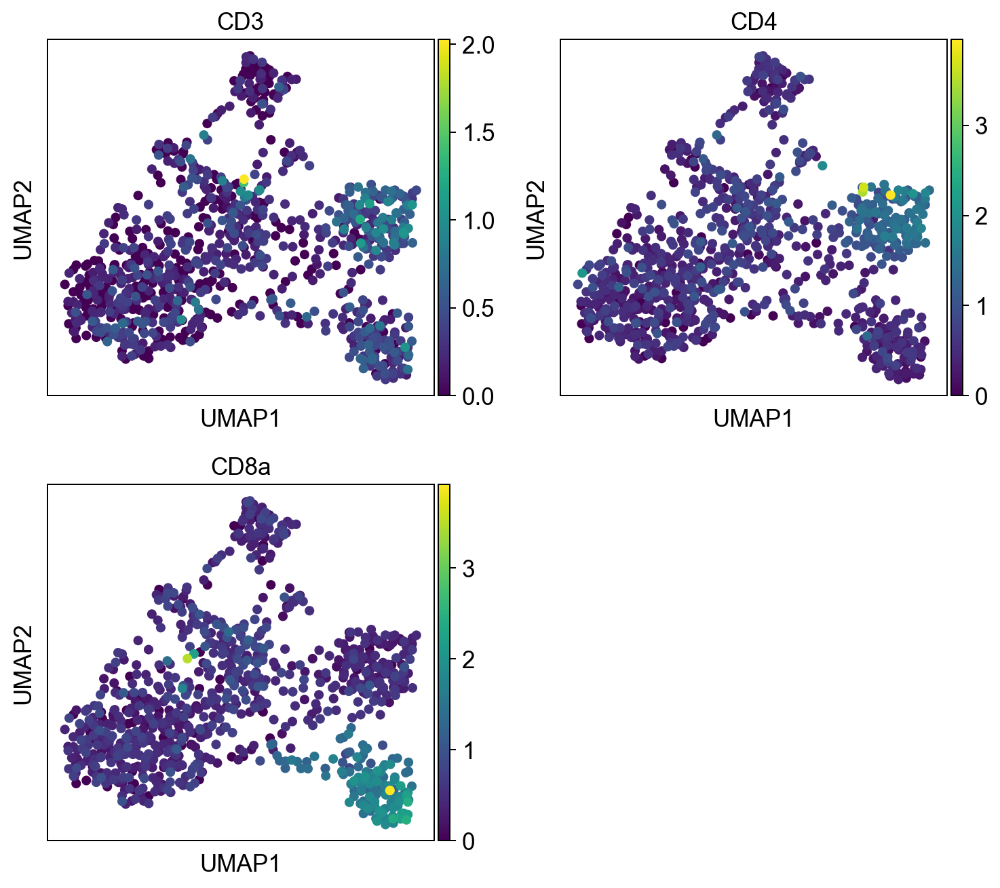

In [121]:
#CLR & EG13 sample

sc.pl.umap(adata_prot_clr[adata_prot_clr.obs['EG_code'] == 'EG13'], color = t_cell, color_map = 'viridis', ncols = 2)

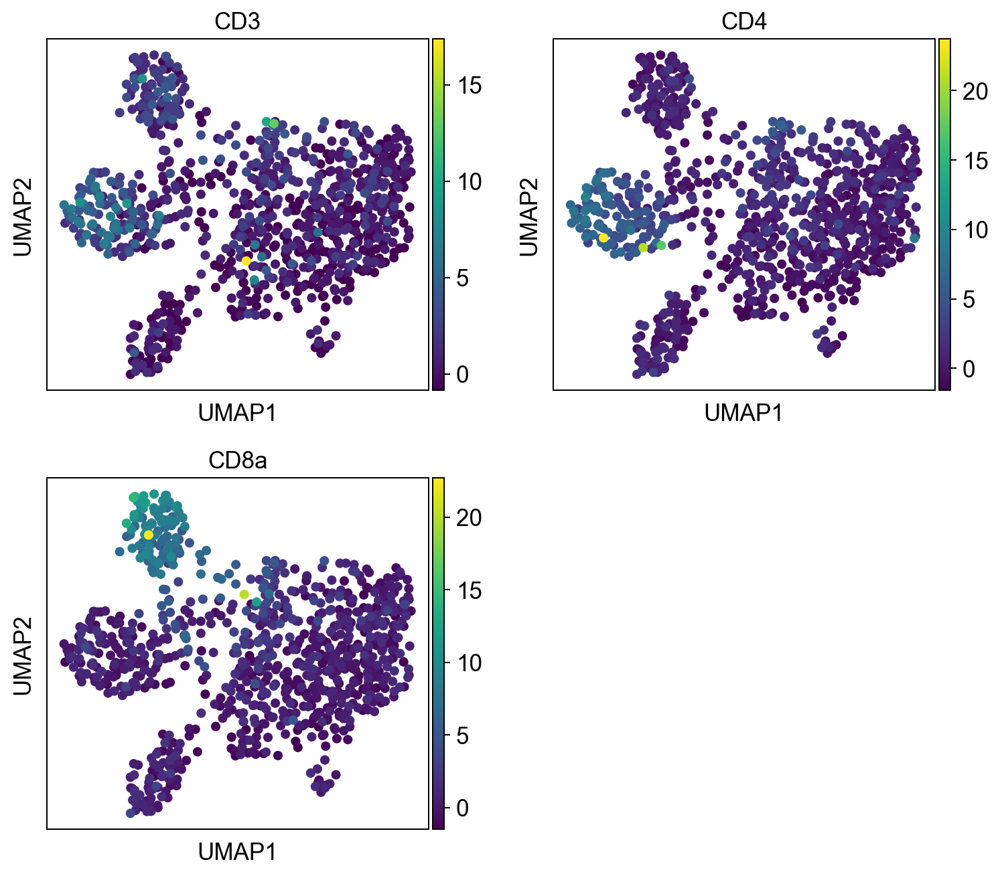

In [122]:
#DSB & EG13 sample

sc.pl.umap(adata_prot_dsb[adata_prot_dsb.obs['EG_code'] == 'EG13'], color = t_cell, color_map = 'viridis', ncols = 2)

## T-cell markers 15 days post diagnosis (EG10)

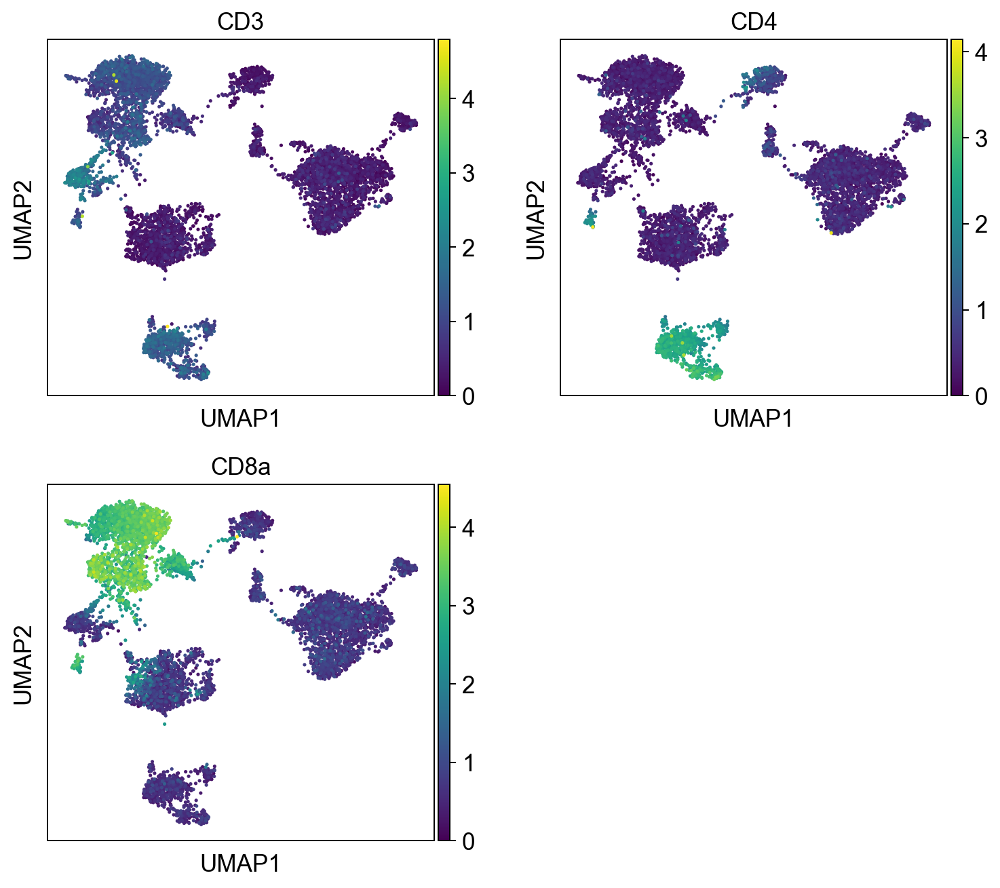

In [123]:
#CLR & EG10 sample

sc.pl.umap(adata_prot_clr[adata_prot_clr.obs['EG_code'] == 'EG10'], color = t_cell, color_map = 'viridis', ncols = 2)

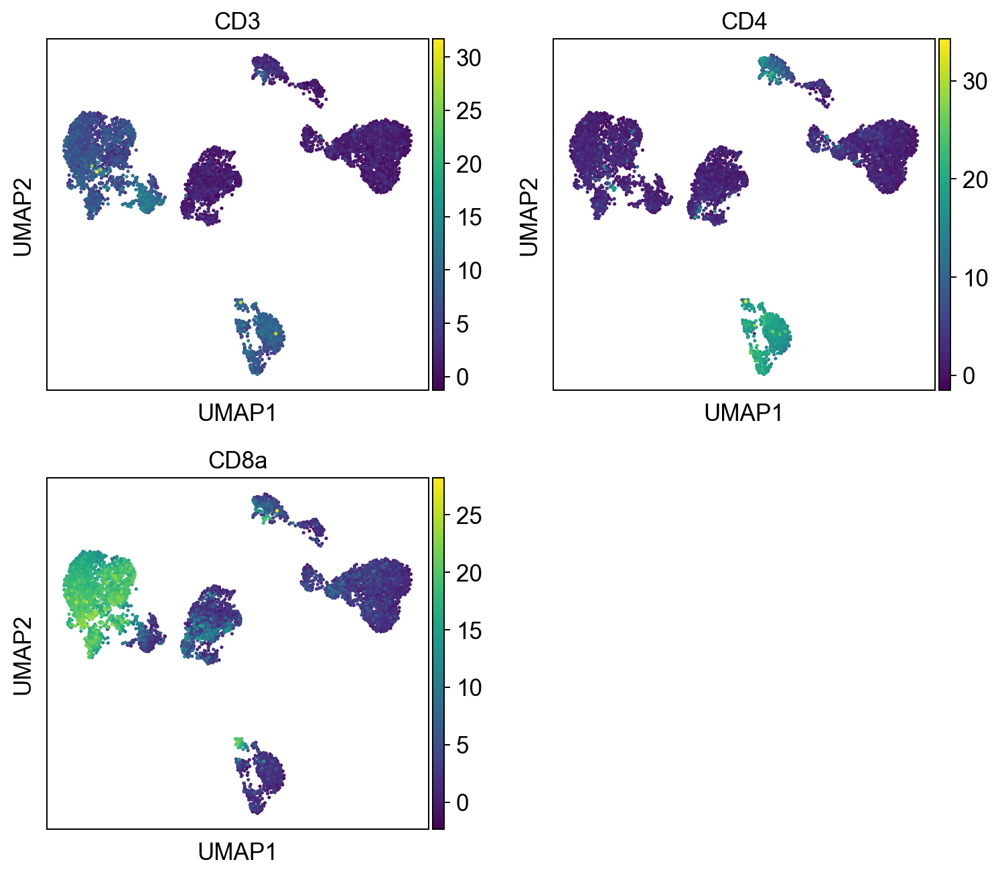

In [124]:
#DSB & EG10 sample

sc.pl.umap(adata_prot_dsb[adata_prot_dsb.obs['EG_code'] == 'EG10'], color = t_cell, color_map = 'viridis', ncols = 2)

## Early B-cell markers at diagnosis (EG13)

In [125]:
#early B

early_b= ['CD38', 'CD24', 'CD10']

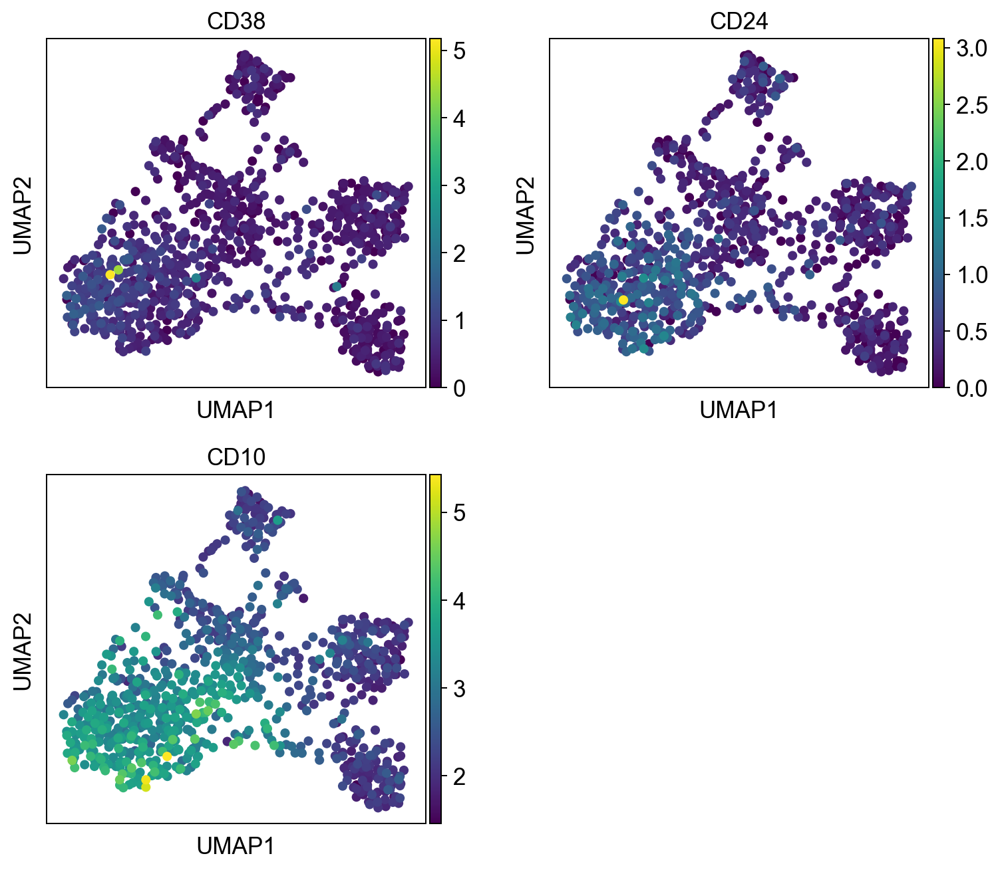

In [126]:
#CLR & EG13 sample

sc.pl.umap(adata_prot_clr[adata_prot_clr.obs['EG_code'] == 'EG13'], color = early_b, color_map = 'viridis', ncols = 2)

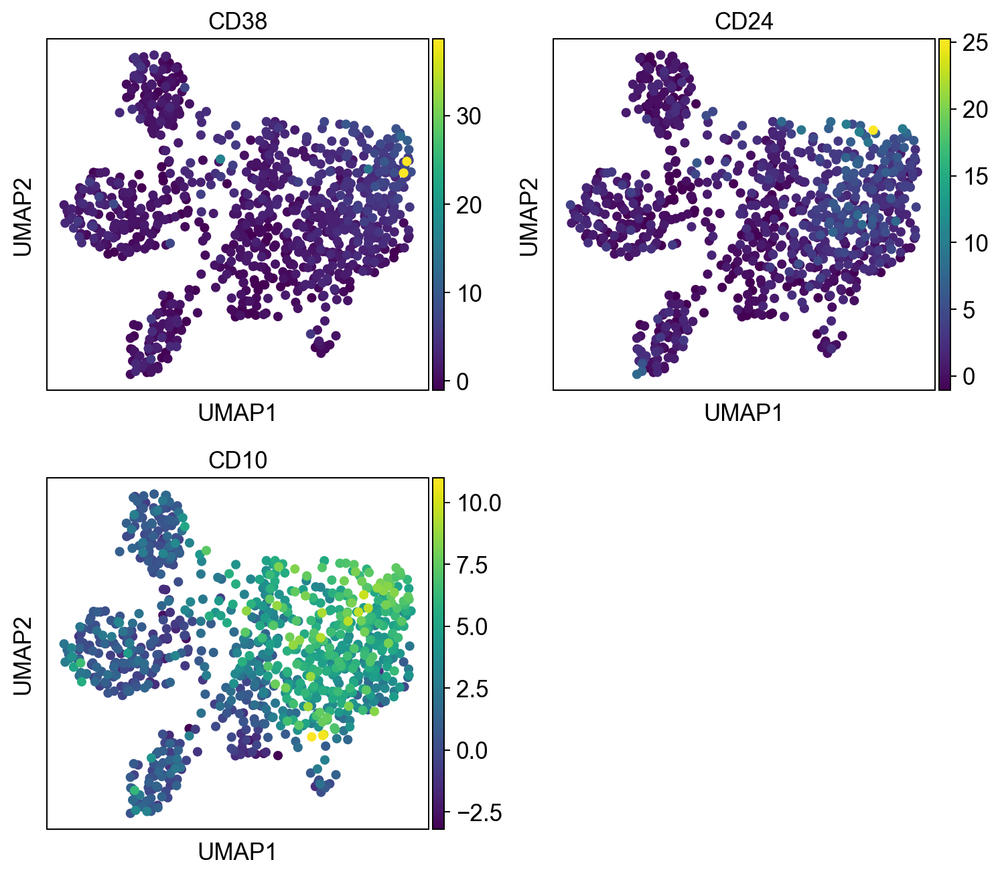

In [127]:
#DSB & EG13 sample

sc.pl.umap(adata_prot_dsb[adata_prot_dsb.obs['EG_code'] == 'EG13'], color = early_b, color_map = 'viridis', ncols = 2)

## Early B-markers 15 days post diagnosis (EG10)

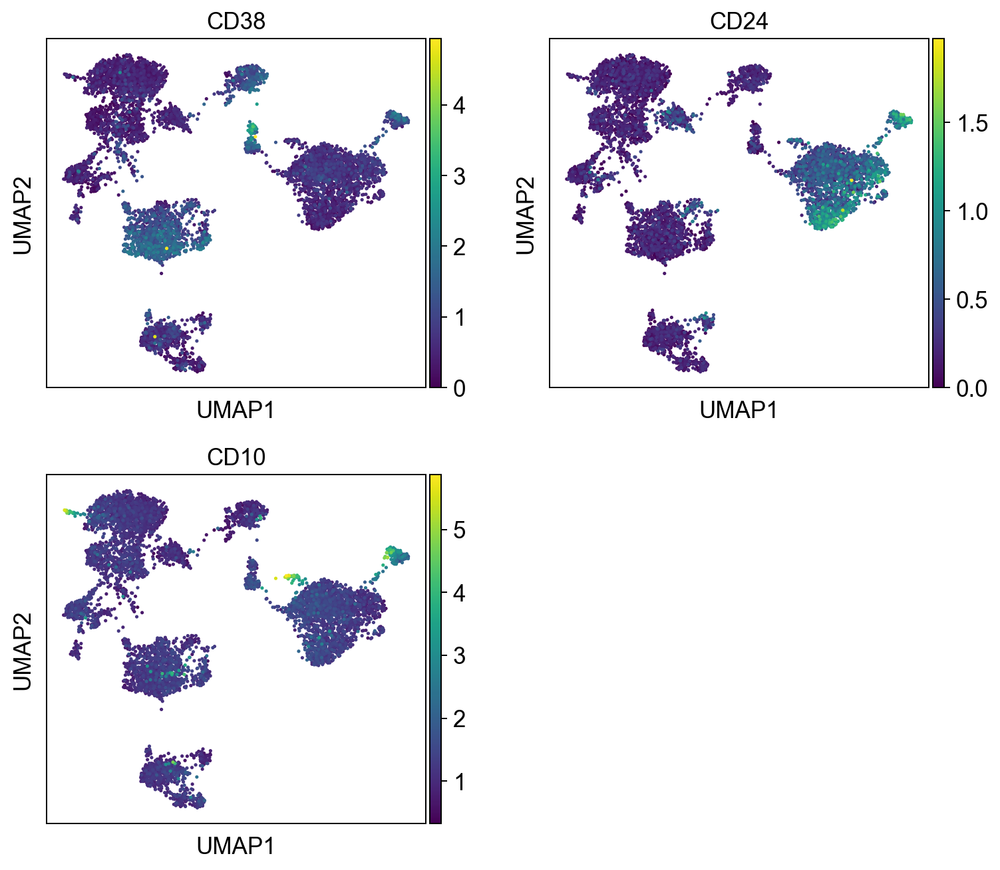

In [128]:
#CLR and EG10 sample

sc.pl.umap(adata_prot_clr[adata_prot_clr.obs['EG_code'] == 'EG10'], color = early_b, color_map = 'viridis', ncols = 2)

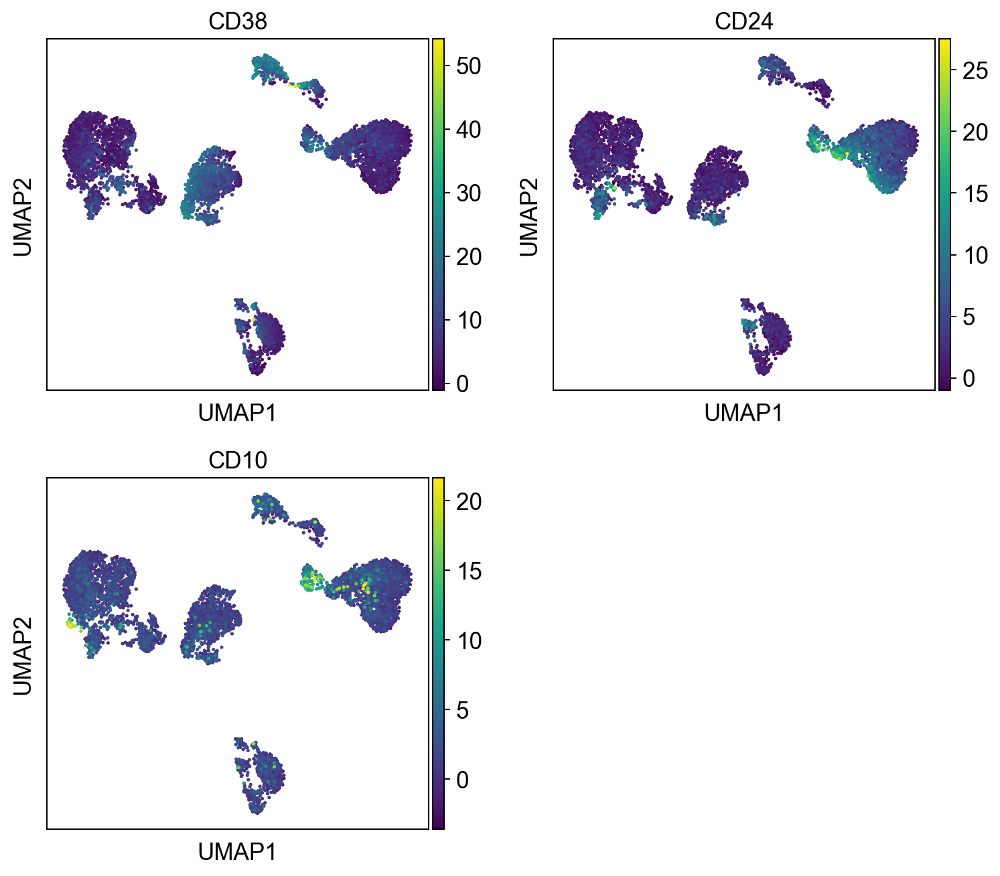

In [129]:
#DSB and EG10 sample

sc.pl.umap(adata_prot_dsb[adata_prot_dsb.obs['EG_code'] == 'EG10'], color = early_b, color_map = 'viridis', ncols = 2)

## Myeloid lineage at diagnosis (EG13)

In [132]:
myeloid = ['CD11b', 'CD13', 'CD14', 'CD64']

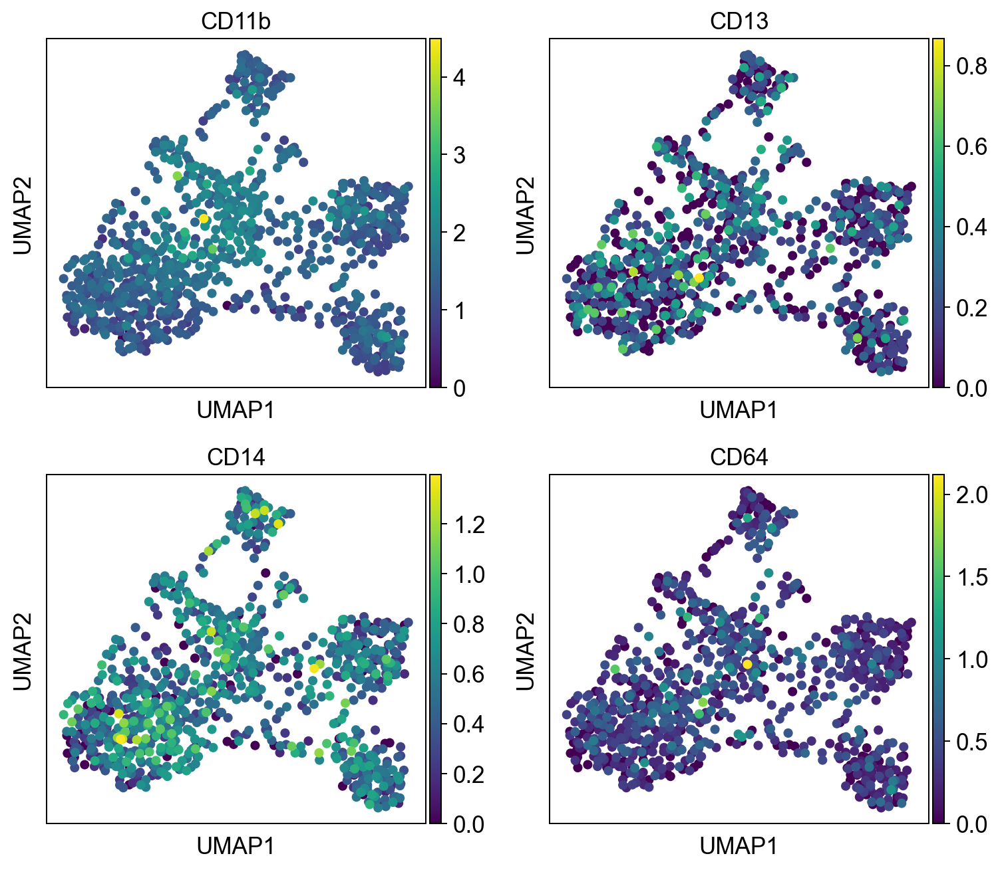

In [133]:
#CLR and EG13 sample

sc.pl.umap(adata_prot_clr[adata_prot_clr.obs['EG_code'] == 'EG13'], color = myeloid, color_map = 'viridis', ncols = 2)

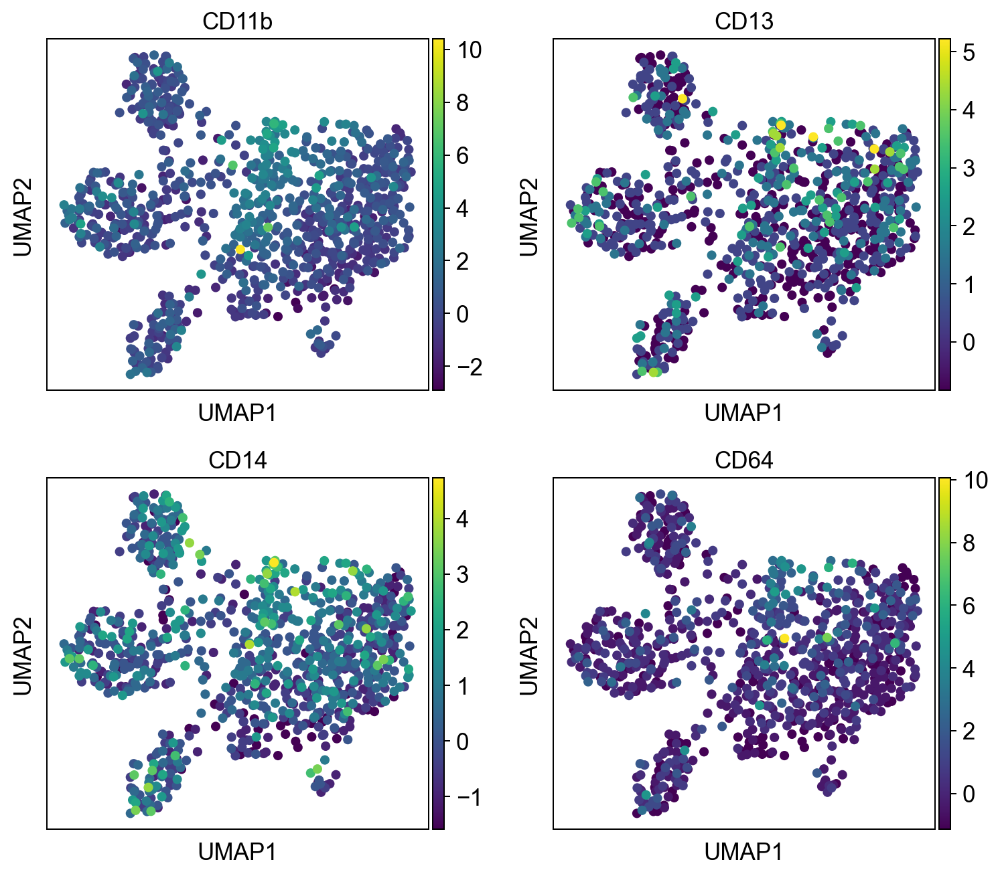

In [134]:
#DSB and EG13 sample

sc.pl.umap(adata_prot_dsb[adata_prot_dsb.obs['EG_code'] == 'EG13'], color = myeloid, color_map = 'viridis', ncols = 2)

## Myeloid lineage 15 days post diagnosis (EG10)

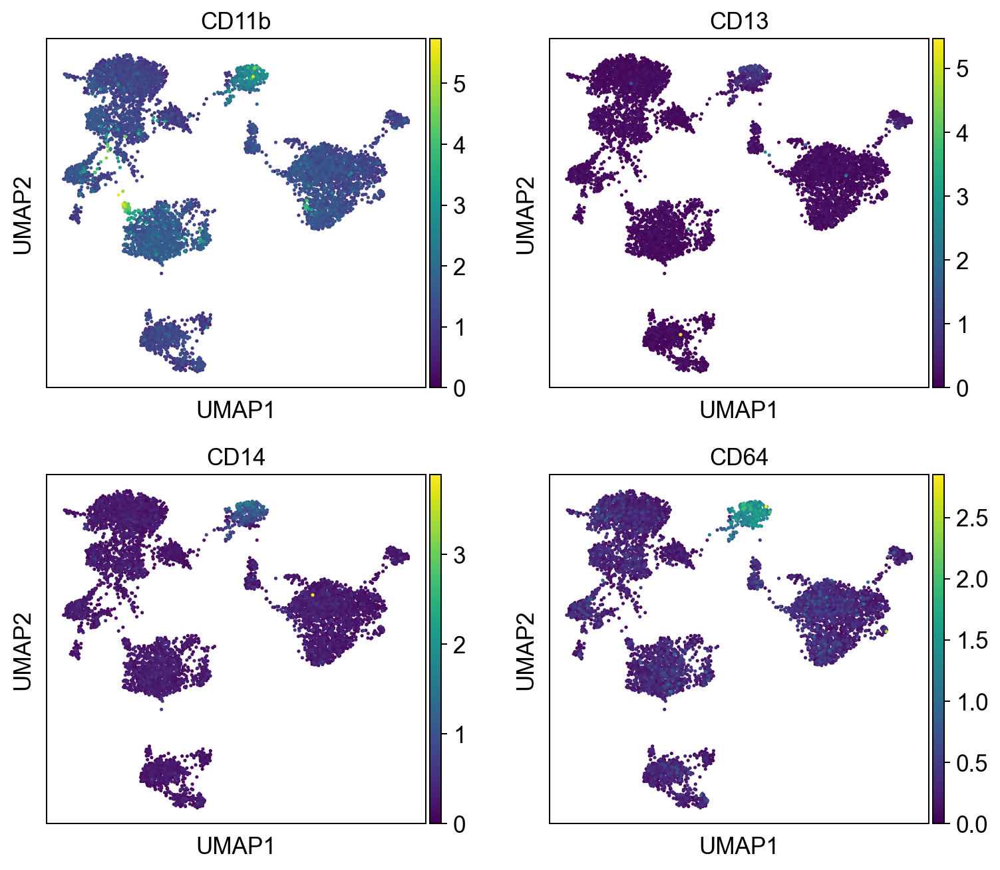

In [135]:
#CLR and EG10 sample

sc.pl.umap(adata_prot_clr[adata_prot_clr.obs['EG_code'] == 'EG10'], color = myeloid, color_map = 'viridis', ncols = 2)

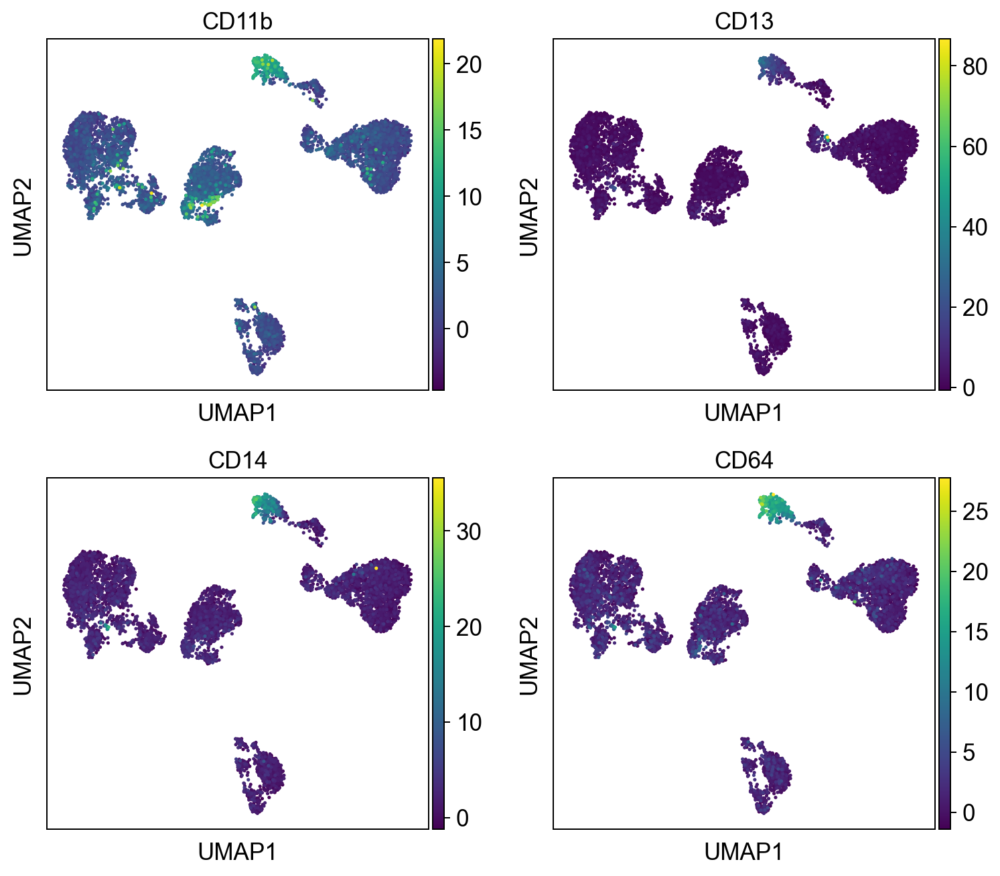

In [136]:
#DSB and EG10 sample

sc.pl.umap(adata_prot_dsb[adata_prot_dsb.obs['EG_code'] == 'EG10'], color = myeloid, color_map = 'viridis', ncols = 2)